# Business Objective:

- Identify crime hotspots and developing prediction models (Logistic Regression, Decision Tree, and Random Forest) to forecast burglary incidents. 
- Assist law enforcement, public safety, and urban planning stakeholders in making informed decisions to enhance crime prevention efforts and resource allocation.

# Technical Objective:

- clean, preprocess, and explore the crime dataset
- visualize the dataset to get insights of crimes in LA city.
- implement Logistic Regression, Decision Tree, and Random Forest algorithms for burglary prediction. 
- identify the most suitable model for predicting burglary incidents accurately and gain valuable insights into crime hotspots in Los Angeles.

<div style="background-color:#F9F2A5;  padding:20px">

Notebook Navigation and Contents, driven by The Data Preprocessing Template


<a id="99"></a>

<h3><a href = "#0">Data Understanding📊🔍</a></h3>
<h3><a href = "#1">Data Exploration🧹🔧</a></h3>  
<h3><a href = "#1">Data Preparation🧹🔧</a></h3>
<h3><a href = "#3">Modeling/ Classification with big dataset📈🧮</a></h3>
<h3><a href = "#4">Modeling/ Classification with Tuned dataset 📊🎯</a></h3>
<h3><a href = "#5">Summary and Reflection📝 </a></h3>
</div>


<div style="background-color:#3b528b;  color:white; padding:20px">
<h2> 1. Import Libraries </h2>
</div>

In [1]:
#Code Block 01

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
import datetime as dt

import warnings
warnings.filterwarnings('ignore')

pd.set_option('display.max_columns',500)
plt.style.use('seaborn')

<div style="background-color:#3b528b;  color:white; padding:20px">
<h2> 2. Import Data </h2>
</div>

In [2]:
#Code Block 2
df_lacrime=pd.read_csv('Crime_Data_from_2020_to_Present.csv',index_col=None,header=0)
df_lacrime.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 757141 entries, 0 to 757140
Data columns (total 28 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   DR_NO           757141 non-null  int64  
 1   Date Rptd       757141 non-null  object 
 2   DATE OCC        757141 non-null  object 
 3   TIME OCC        757141 non-null  int64  
 4   AREA            757141 non-null  int64  
 5   AREA NAME       757141 non-null  object 
 6   Rpt Dist No     757141 non-null  int64  
 7   Part 1-2        757141 non-null  int64  
 8   Crm Cd          757141 non-null  int64  
 9   Crm Cd Desc     757141 non-null  object 
 10  Mocodes         653226 non-null  object 
 11  Vict Age        757141 non-null  int64  
 12  Vict Sex        658230 non-null  object 
 13  Vict Descent    658224 non-null  object 
 14  Premis Cd       757132 non-null  float64
 15  Premis Desc     756699 non-null  object 
 16  Weapon Used Cd  263079 non-null  float64
 17  Weapon Des

In [3]:
#Code Block 3
df_lacrime.head(2)

,DR_NO,Date Rptd,DATE OCC,TIME OCC,AREA,AREA NAME,Rpt Dist No,Part 1-2,Crm Cd,Crm Cd Desc,Mocodes,Vict Age,Vict Sex,Vict Descent,Premis Cd,Premis Desc,Weapon Used Cd,Weapon Desc,Status,Status Desc,Crm Cd 1,Crm Cd 2,Crm Cd 3,Crm Cd 4,LOCATION,Cross Street,LAT,LON
0,10304468,01/08/2020 12:00:00 AM,01/08/2020 12:00:00 AM,2230,3,Southwest,377,2,624,BATTERY - SIMPLE ASSAULT,0444 0913,36,F,B,501.0,SINGLE FAMILY DWELLING,400.0,"STRONG-ARM (HANDS, FIST, FEET OR BODILY FORCE)",AO,Adult Other,624.0,NaN,NaN,NaN,1100 W 39TH PL,NaN,34.0141,-118.2978
1,190101086,01/02/2020 12:00:00 AM,01/01/2020 12:00:00 AM,330,1,Central,163,2,624,BATTERY - SIMPLE ASSAULT,0416 1822 1414,25,M,H,102.0,SIDEWALK,500.0,UNKNOWN WEAPON/OTHER WEAPON,IC,Invest Cont,624.0,NaN,NaN,NaN,700 S HILL ST,NaN,34.0459,-118.2545


In [4]:
#Code Block 4
df_lacrime=df_lacrime.replace("",np.nan) #find all empty strings and replace them with NAN values
df_lacrime.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 757141 entries, 0 to 757140
Data columns (total 28 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   DR_NO           757141 non-null  int64  
 1   Date Rptd       757141 non-null  object 
 2   DATE OCC        757141 non-null  object 
 3   TIME OCC        757141 non-null  int64  
 4   AREA            757141 non-null  int64  
 5   AREA NAME       757141 non-null  object 
 6   Rpt Dist No     757141 non-null  int64  
 7   Part 1-2        757141 non-null  int64  
 8   Crm Cd          757141 non-null  int64  
 9   Crm Cd Desc     757141 non-null  object 
 10  Mocodes         653226 non-null  object 
 11  Vict Age        757141 non-null  int64  
 12  Vict Sex        658230 non-null  object 
 13  Vict Descent    658224 non-null  object 
 14  Premis Cd       757132 non-null  float64
 15  Premis Desc     756699 non-null  object 
 16  Weapon Used Cd  263079 non-null  float64
 17  Weapon Des

In [5]:
#Code Block 5
missing_values = df_lacrime.isnull().sum()  # missing values in the dataset
print(missing_values)

DR_NO                  0
Date Rptd              0
DATE OCC               0
TIME OCC               0
AREA                   0
AREA NAME              0
Rpt Dist No            0
Part 1-2               0
Crm Cd                 0
Crm Cd Desc            0
Mocodes           103915
Vict Age               0
Vict Sex           98911
Vict Descent       98917
Premis Cd              9
Premis Desc          442
Weapon Used Cd    494062
Weapon Desc       494062
Status                 0
Status Desc            0
Crm Cd 1              10
Crm Cd 2          701125
Crm Cd 3          755269
Crm Cd 4          757085
LOCATION               0
Cross Street      635409
LAT                    0
LON                    0
dtype: int64


- There are 757141 entries, and some varaibles with a lot of null values. 
- Drop variables'Crm Cd 2','Crm Cd 3', 'Crm Cd 4','Cross Street' because of fewer entries for analysis.
- Drop variables'Crm Cd 1','Weapon Used Cd','Mocodes'for little relationship with objective of project. 

<div style="background-color:#3b528b;  color:white; padding:20px">

<a href="#99" style="color:white;"> Top ⬆️</a>

<a id="0"></a>

<h2> Data Understanding: 📊🔍</h2>
</div>

    - Format the data
    - View, explore, and summarize the data


<font color="blue">Convert date to elements of a date(date,month,year,etc.)</font>

In [6]:
#Code Block 6
df_lacrime['Date Rptd'] = pd.to_datetime(df_lacrime['Date Rptd'])
df_lacrime['DATE OCC'] = pd.to_datetime(df_lacrime['DATE OCC'])

In [7]:
#Code Block 7
df_lacrime['Year'] = df_lacrime['DATE OCC'].dt.year
df_lacrime['Month'] = df_lacrime['DATE OCC'].dt.month
df_lacrime['Date'] = df_lacrime['DATE OCC'].dt.day
df_lacrime['DayofWeek'] = df_lacrime['DATE OCC'].dt.dayofweek

In [8]:
#Code Block 8
df_lacrime['DayofWeek'].value_counts()

4    115490
5    110492
2    107723
0    107323
3    106801
6    105489
1    103823
Name: DayofWeek, dtype: int64

In [9]:
#Code Block 9
weekday_mapping = {
    0: 'Monday',
    1: 'Tuesday',
    2: 'Wednesday',
    3: 'Thursday',
    4: 'Friday',
    5: 'Saturday',
    6: 'Sunday'
}

In [10]:
#Code Block 10
df_lacrime['DayofWeek'] = df_lacrime['DATE OCC'].dt.dayofweek.map(weekday_mapping)

In [11]:
#Code Block 11
df_lacrime['TIME OCC'] = df_lacrime['TIME OCC'].astype(str).str.zfill(4)

# Add colons to the "TIME OCC" column to format it as "22:30:00"
df_lacrime['TIME OCC'] = df_lacrime['TIME OCC'].str[:2] + ':' + df_lacrime['TIME OCC'].str[2:] + ':00'

In [12]:
#Code Block 12
df_lacrime.head()

,DR_NO,Date Rptd,DATE OCC,TIME OCC,AREA,AREA NAME,Rpt Dist No,Part 1-2,Crm Cd,Crm Cd Desc,Mocodes,Vict Age,Vict Sex,Vict Descent,Premis Cd,Premis Desc,Weapon Used Cd,Weapon Desc,Status,Status Desc,Crm Cd 1,Crm Cd 2,Crm Cd 3,Crm Cd 4,LOCATION,Cross Street,LAT,LON,Year,Month,Date,DayofWeek
0,10304468,2020-01-08,2020-01-08,22:30:00,3,Southwest,377,2,624,BATTERY - SIMPLE ASSAULT,0444 0913,36,F,B,501.0,SINGLE FAMILY DWELLING,400.0,"STRONG-ARM (HANDS, FIST, FEET OR BODILY FORCE)",AO,Adult Other,624.0,NaN,NaN,NaN,1100 W 39TH PL,NaN,34.0141,-118.2978,2020,1,8,Wednesday
1,190101086,2020-01-02,2020-01-01,03:30:00,1,Central,163,2,624,BATTERY - SIMPLE ASSAULT,0416 1822 1414,25,M,H,102.0,SIDEWALK,500.0,UNKNOWN WEAPON/OTHER WEAPON,IC,Invest Cont,624.0,NaN,NaN,NaN,700 S HILL ST,NaN,34.0459,-118.2545,2020,1,1,Wednesday
2,200110444,2020-04-14,2020-02-13,12:00:00,1,Central,155,2,845,SEX OFFENDER REGISTRANT OUT OF COMPLIANCE,1501,0,X,X,726.0,POLICE FACILITY,NaN,NaN,AA,Adult Arrest,845.0,NaN,NaN,NaN,200 E 6TH ST,NaN,34.0448,-118.2474,2020,2,13,Thursday
3,191501505,2020-01-01,2020-01-01,17:30:00,15,N Hollywood,1543,2,745,VANDALISM - MISDEAMEANOR ($399 OR UNDER),0329 1402,76,F,W,502.0,"MULTI-UNIT DWELLING (APARTMENT, DUPLEX, ETC)",NaN,NaN,IC,Invest Cont,745.0,998.0,NaN,NaN,5400 CORTEEN PL,NaN,34.1685,-118.4019,2020,1,1,Wednesday
4,191921269,2020-01-01,2020-01-01,04:15:00,19,Mission,1998,2,740,"VANDALISM - FELONY ($400 & OVER, ALL CHURCH VA...",0329,31,X,X,409.0,BEAUTY SUPPLY STORE,NaN,NaN,IC,Invest Cont,740.0,NaN,NaN,NaN,14400 TITUS ST,NaN,34.2198,-118.4468,2020,1,1,Wednesday


In [13]:
#Code Block 13
def get_time_of_day(time_str):
    hour = int(time_str[:2])
    if 5 <= hour < 12:
        return 'Morning'
    elif 12 <= hour < 17:
        return 'Afternoon'
    elif 17 <= hour < 21:
        return 'Evening'
    else:
        return 'Night'

In [14]:
#Code Block 14
df_lacrime['Time of Day'] = df_lacrime['TIME OCC'].apply(get_time_of_day)

<div style="background-color:#3b528b;  color:white; padding:20px">

<a href="#99" style="color:white;"> Top ⬆️</a>

<a id="1"></a>

<h2>  Data Exploration and Preparation: 📊🔍</h2>
</div>

    - Remove Columns
    - Remove Rows
    - Fill in null values
    - Replace or Remove mistakes
    - Format the titles
    - Recode categorical or numerical features
    - Construct new data feature engineering
    - Visualize the variables


     

In [15]:
#Code Block 15
df_lacrime.head(2)

,DR_NO,Date Rptd,DATE OCC,TIME OCC,AREA,AREA NAME,Rpt Dist No,Part 1-2,Crm Cd,Crm Cd Desc,Mocodes,Vict Age,Vict Sex,Vict Descent,Premis Cd,Premis Desc,Weapon Used Cd,Weapon Desc,Status,Status Desc,Crm Cd 1,Crm Cd 2,Crm Cd 3,Crm Cd 4,LOCATION,Cross Street,LAT,LON,Year,Month,Date,DayofWeek,Time of Day
0,10304468,2020-01-08,2020-01-08,22:30:00,3,Southwest,377,2,624,BATTERY - SIMPLE ASSAULT,0444 0913,36,F,B,501.0,SINGLE FAMILY DWELLING,400.0,"STRONG-ARM (HANDS, FIST, FEET OR BODILY FORCE)",AO,Adult Other,624.0,NaN,NaN,NaN,1100 W 39TH PL,NaN,34.0141,-118.2978,2020,1,8,Wednesday,Night
1,190101086,2020-01-02,2020-01-01,03:30:00,1,Central,163,2,624,BATTERY - SIMPLE ASSAULT,0416 1822 1414,25,M,H,102.0,SIDEWALK,500.0,UNKNOWN WEAPON/OTHER WEAPON,IC,Invest Cont,624.0,NaN,NaN,NaN,700 S HILL ST,NaN,34.0459,-118.2545,2020,1,1,Wednesday,Night


### Temporal Analysis 

In [16]:
#Code Block 16
df_lacrime = df_lacrime[(df_lacrime['DATE OCC'].dt.year >= 2020) & (df_lacrime['DATE OCC'].dt.year <= 2023)]

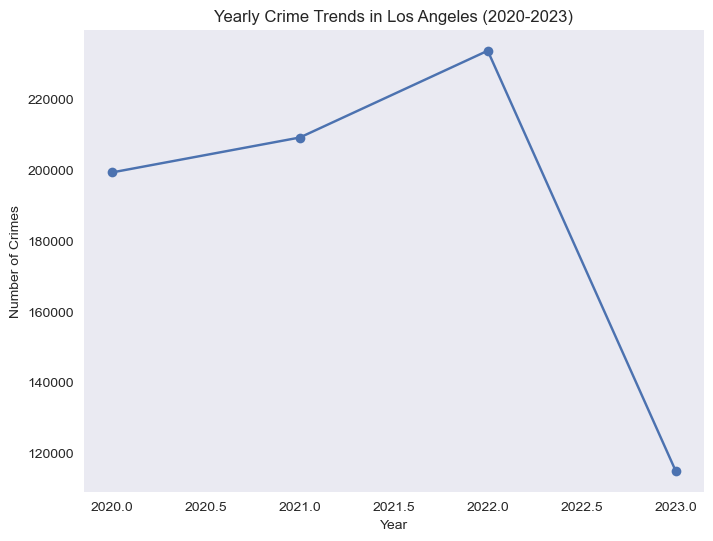

In [17]:
#Code Block 17
yearly_crime_counts = df_lacrime['DATE OCC'].dt.year.value_counts().sort_index()
plt.figure(figsize=(8, 6))
plt.plot(yearly_crime_counts.index.astype(int), yearly_crime_counts.values, marker='o')
plt.xlabel('Year')
plt.ylabel('Number of Crimes')
plt.title('Yearly Crime Trends in Los Angeles (2020-2023)')
plt.grid()
plt.show()

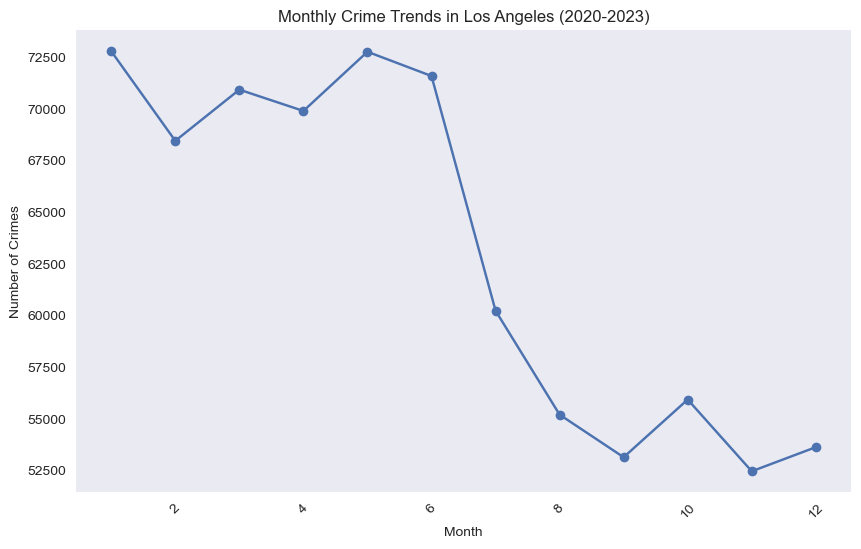

In [18]:
#Code Block 18
monthly_crime_counts = df_lacrime['Month'].value_counts().sort_index()
plt.figure(figsize=(10, 6))
plt.plot(monthly_crime_counts.index, monthly_crime_counts.values, marker='o')
plt.xlabel('Month')
plt.ylabel('Number of Crimes')
plt.title('Monthly Crime Trends in Los Angeles (2020-2023)')
plt.grid()
plt.xticks(rotation=45)
plt.show()

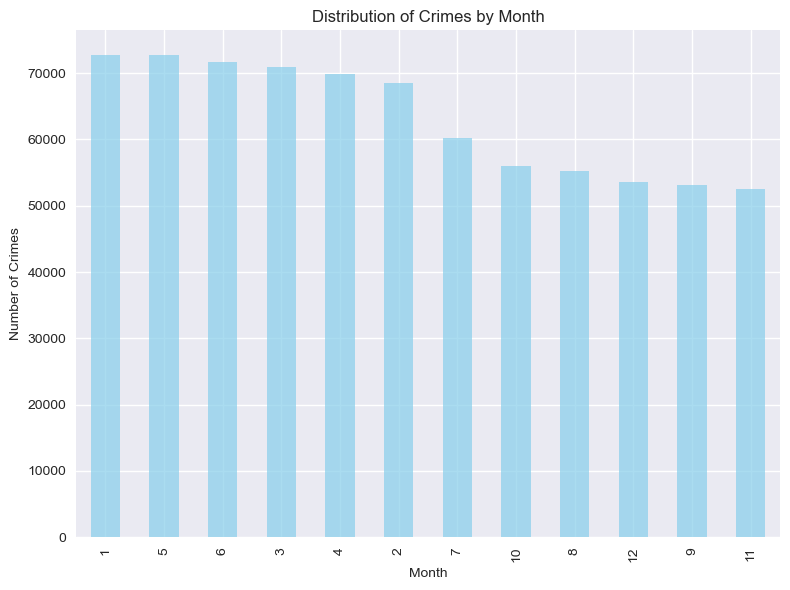

In [19]:
#Code Block 19
month_counts = df_lacrime['Month'].value_counts()

# Create a figure and axis
fig, ax = plt.subplots(figsize=(8, 6))

# Plot the bar chart
month_counts.plot(kind='bar', ax=ax, color='skyblue', alpha=0.7)

# Set the title and labels
ax.set_title('Distribution of Crimes by Month')
ax.set_xlabel('Month')
ax.set_ylabel('Number of Crimes')
# Show the plot
plt.tight_layout()
plt.show()

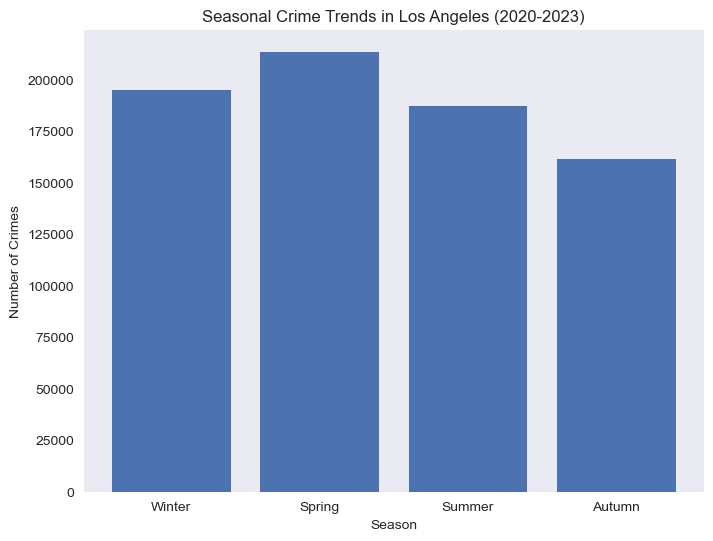

In [20]:
#Code Block 20
def get_season(month):
    if month in [12, 1, 2]:
        return 'Winter'
    elif month in [3, 4, 5]:
        return 'Spring'
    elif month in [6, 7, 8]:
        return 'Summer'
    else:
        return 'Autumn'

df_lacrime['Season'] = df_lacrime['Month'].apply(get_season)
seasonal_crime_counts = df_lacrime['Season'].value_counts().reindex(['Winter', 'Spring', 'Summer', 'Autumn'])
plt.figure(figsize=(8, 6))
plt.bar(seasonal_crime_counts.index, seasonal_crime_counts.values)
plt.xlabel('Season')
plt.ylabel('Number of Crimes')
plt.title('Seasonal Crime Trends in Los Angeles (2020-2023)')
plt.grid()
plt.show()

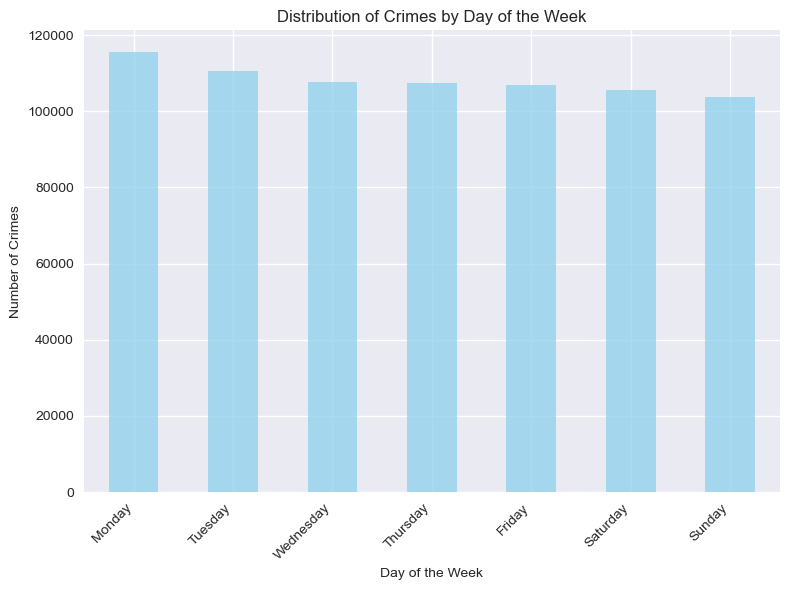

In [21]:
#Code Block 21
day_of_week_counts = df_lacrime['DayofWeek'].value_counts()

# Create a figure and axis
fig, ax = plt.subplots(figsize=(8, 6))

# Plot the bar chart
day_of_week_counts.plot(kind='bar', ax=ax, color='skyblue', alpha=0.7)

# Set the title and labels
ax.set_title('Distribution of Crimes by Day of the Week')
ax.set_xlabel('Day of the Week')
ax.set_ylabel('Number of Crimes')

# Reorder the x-axis labels (days of the week) for better readability
days_of_week = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
ax.set_xticklabels(days_of_week, rotation=45, ha='right')

# Show the plot
plt.tight_layout()
plt.show()

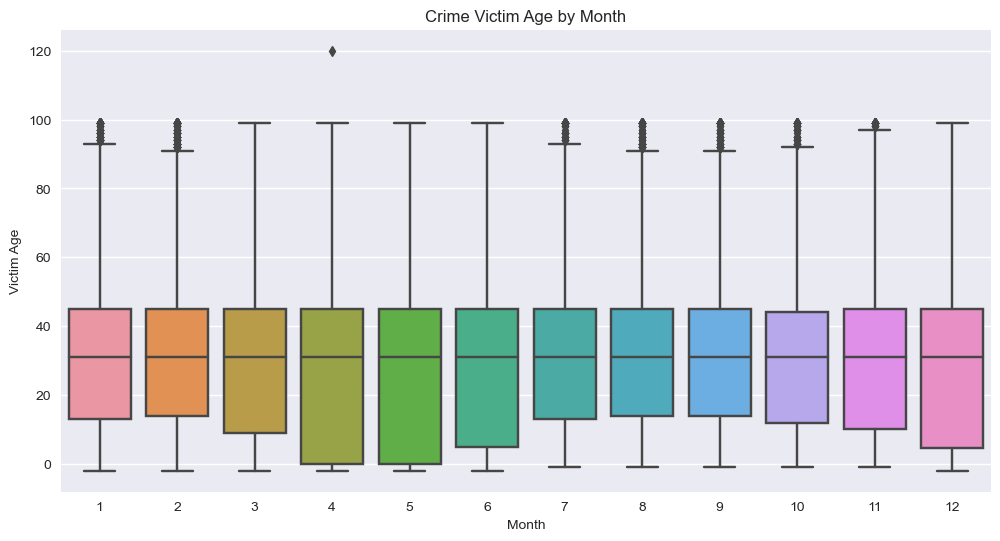

In [22]:
#Code Block 22
plt.figure(figsize=(12, 6))
sns.boxplot(x='Month', y='Vict Age', data=df_lacrime)  
plt.title('Crime Victim Age by Month')
plt.xlabel('Month')
plt.ylabel('Victim Age')
plt.show()

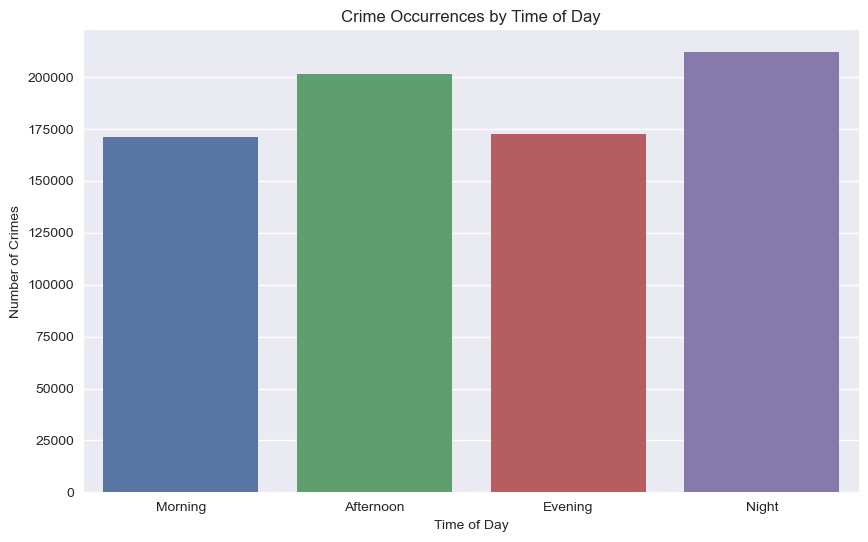

In [23]:
#Code Block 23
plt.figure(figsize=(10, 6))
sns.countplot(x='Time of Day', data=df_lacrime, order=['Morning', 'Afternoon', 'Evening', 'Night'])
plt.title('Crime Occurrences by Time of Day')
plt.xlabel('Time of Day')
plt.ylabel('Number of Crimes')
plt.show()

In [24]:
#Code Block 24
import pandas as pd
import plotly.express as px
df_date = df_lacrime.groupby('Date Rptd')['Crm Cd'].count().reset_index(name='Total Cases')

line_crime_date = px.line(data_frame=df_date, x='Date Rptd', y='Total Cases', title="Criminal Cases")
line_crime_date.update_layout(xaxis_title='Date Reported', yaxis_title='Total Cases')

line_crime_date.show()

In [25]:
#Code Block 25
df_date1 = df_lacrime.groupby('DATE OCC')['Crm Cd'].count().reset_index(name='Total Cases')

line_crime_date = px.line(data_frame=df_date1, x='DATE OCC', y='Total Cases', title="Criminal Cases")
line_crime_date.update_layout(xaxis_title='Date Occurred', yaxis_title='Total Cases')

line_crime_date.show()

In [26]:
#Code Block 26
date_range = pd.date_range(start="2020-01-01", end="2023-07-10", freq='D')
date_range

DatetimeIndex(['2020-01-01', '2020-01-02', '2020-01-03', '2020-01-04',
               '2020-01-05', '2020-01-06', '2020-01-07', '2020-01-08',
               '2020-01-09', '2020-01-10',
               ...
               '2023-07-01', '2023-07-02', '2023-07-03', '2023-07-04',
               '2023-07-05', '2023-07-06', '2023-07-07', '2023-07-08',
               '2023-07-09', '2023-07-10'],
              dtype='datetime64[ns]', length=1287, freq='D')

In [27]:
#Code Block 27
start_date = pd.to_datetime("2020-01-01")
end_date = pd.to_datetime("2023-07-31")
filtered_data = df_lacrime[(df_lacrime['DATE OCC'] >= start_date) & (df_lacrime['DATE OCC'] <= end_date)]

# Calculate the total number of crimes during the period
total_crime_count = filtered_data.shape[0]

# Calculate the number of days in the date range
number_of_days = (end_date - start_date).days + 1

# Calculate the average number of crimes per day
average_crime_per_day = round(total_crime_count / number_of_days,2)

print("Total number of crimes between 2020-01-01 and 2023-07-31:", total_crime_count)
print("Number of days in the date range:", number_of_days)
print("Average number of crimes per day between 2020-01-01 and 2023-07-31:", average_crime_per_day)

Total number of crimes between 2020-01-01 and 2023-07-31: 757141
Number of days in the date range: 1308
Average number of crimes per day between 2020-01-01 and 2023-07-31: 578.85


### Weapon Description 

In [28]:
#Code Block 28
df_lacrime['Weapon Desc'].value_counts()

STRONG-ARM (HANDS, FIST, FEET OR BODILY FORCE)    141322
UNKNOWN WEAPON/OTHER WEAPON                        27323
VERBAL THREAT                                      19409
HAND GUN                                           16320
SEMI-AUTOMATIC PISTOL                               6006
                                                   ...  
MAC-11 SEMIAUTOMATIC ASSAULT WEAPON                    3
MAC-10 SEMIAUTOMATIC ASSAULT WEAPON                    2
M1-1 SEMIAUTOMATIC ASSAULT RIFLE                       1
HECKLER & KOCH 91 SEMIAUTOMATIC ASSAULT RIFLE          1
M-14 SEMIAUTOMATIC ASSAULT RIFLE                       1
Name: Weapon Desc, Length: 79, dtype: int64

In [29]:
#Code Block 29
crime_weapon=df_lacrime[df_lacrime['Weapon Desc'] != 'Unknown']
weapon_counts = crime_weapon['Weapon Desc'].value_counts().nlargest(10)
print(weapon_counts)

STRONG-ARM (HANDS, FIST, FEET OR BODILY FORCE)    141322
UNKNOWN WEAPON/OTHER WEAPON                        27323
VERBAL THREAT                                      19409
HAND GUN                                           16320
SEMI-AUTOMATIC PISTOL                               6006
KNIFE WITH BLADE 6INCHES OR LESS                    5504
UNKNOWN FIREARM                                     5347
OTHER KNIFE                                         4764
MACE/PEPPER SPRAY                                   2920
VEHICLE                                             2662
Name: Weapon Desc, dtype: int64


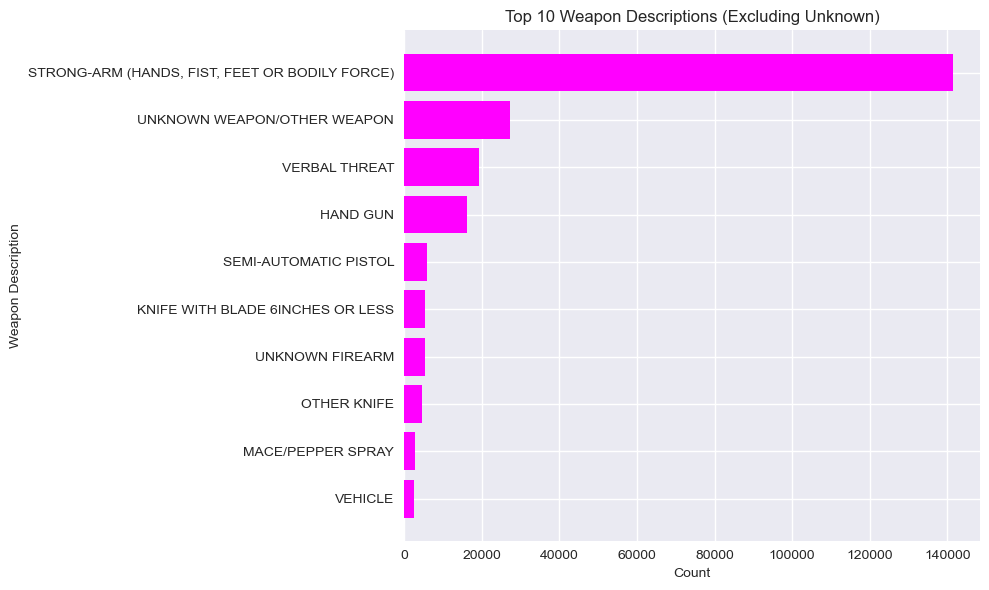

In [30]:
#Code Block 30
plt.figure(figsize=(10, 6))
weapon_counts = weapon_counts.sort_values(ascending=True)
plt.barh(weapon_counts.index, weapon_counts.values, color='magenta')
plt.ylabel('Weapon Description')
plt.xlabel('Count')
plt.title('Top 10 Weapon Descriptions (Excluding Unknown)')
plt.tight_layout()  # Optional: Adjust layout for better visualization
plt.show()

### Explore the victim demographics(vict age, vict sex, vict descent)</font>

In [31]:
#Code Block 31
df_lacrime.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 757141 entries, 0 to 757140
Data columns (total 34 columns):
 #   Column          Non-Null Count   Dtype         
---  ------          --------------   -----         
 0   DR_NO           757141 non-null  int64         
 1   Date Rptd       757141 non-null  datetime64[ns]
 2   DATE OCC        757141 non-null  datetime64[ns]
 3   TIME OCC        757141 non-null  object        
 4   AREA            757141 non-null  int64         
 5   AREA NAME       757141 non-null  object        
 6   Rpt Dist No     757141 non-null  int64         
 7   Part 1-2        757141 non-null  int64         
 8   Crm Cd          757141 non-null  int64         
 9   Crm Cd Desc     757141 non-null  object        
 10  Mocodes         653226 non-null  object        
 11  Vict Age        757141 non-null  int64         
 12  Vict Sex        658230 non-null  object        
 13  Vict Descent    658224 non-null  object        
 14  Premis Cd       757132 non-null  flo

In [32]:
#Code Block 32
df_vict= df_lacrime[['Vict Age', 'Vict Sex', 'Vict Descent']].copy()

In [33]:
#Code Block 33
df_vict["Vict Sex"].value_counts()

M    313598
F    279785
X     64759
H        87
-         1
Name: Vict Sex, dtype: int64

In [34]:
#Code Block 34
df_vict['Vict Sex'] = df_vict['Vict Sex'].replace(['-', 'H'], 'X')

In [35]:
#Code Block 35
df_vict['Vict Sex'].value_counts()

M    313598
F    279785
X     64847
Name: Vict Sex, dtype: int64

Text(0.5, 1.0, 'Distribution of Vict Sex')

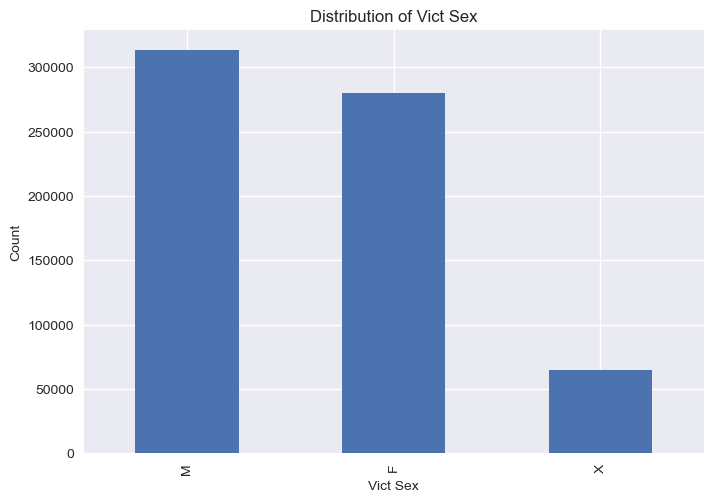

In [36]:
#Code Block 36
sex_counts = df_vict['Vict Sex'].value_counts()

# Create a bar plot to visualize the distribution of 'Vict Sex'
sex_counts.plot(kind='bar')

# Set the labels and title of the plot
plt.xlabel('Vict Sex')
plt.ylabel('Count')
plt.title('Distribution of Vict Sex')


In [37]:
#Code Block 37
age_counts = df_vict['Vict Age'].value_counts()
age_counts

 0      184858
 30      17367
 35      16998
 31      16608
 29      16574
         ...  
 98         59
 97         57
-1          48
-2          11
 120         1
Name: Vict Age, Length: 102, dtype: int64

<Axes: xlabel='Vict Age', ylabel='Density'>

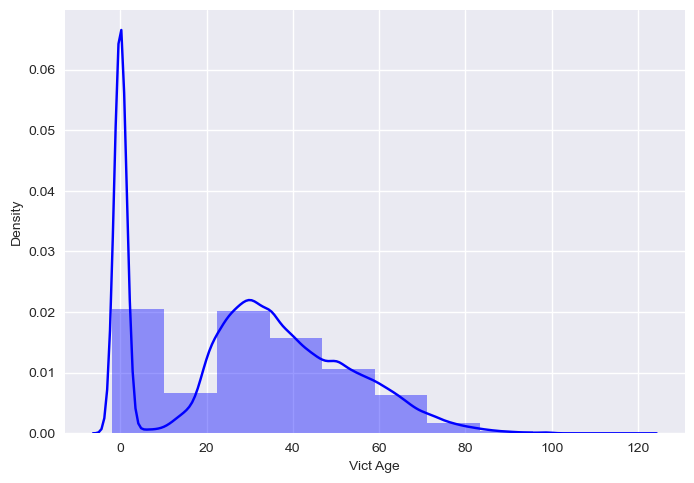

In [38]:
#Code Block 38
sns.distplot(df_vict['Vict Age'],color="b",bins=10)

<font color="blue">There are some 0 or negative values in Vict Age </font>

In [39]:
#Code Block 39
# drop null values in "Vict Age"
vict_age=df_vict.dropna(subset=['Vict Age'])

In [40]:
#Code Block 40
average_age = round(df_lacrime['Vict Age'].mean(),2)
print("Average Victim Age:", average_age)

Average Victim Age: 29.91


In [41]:
#Code Block 41
negative_or_zero_ages = (vict_age['Vict Age'] <= 0).any()
if negative_or_zero_ages:
    print("There are negative or zero ages in the Vict Age column.")
else:
    print("There are no negative or zero ages in the Vict Age column.")

There are negative or zero ages in the Vict Age column.


In [42]:
#Code Block 42
def age_group(age):
    if age <= 0:
        return 'Unknown'  # or 'Missing' if ages are missing
    elif age <= 12:
        return 'Child'
    elif age <= 18:
        return 'Teenager'
    elif age <= 65:
        return 'Adult'
    else:
        return 'Senior'

df_vict['Age Group'] = vict_age['Vict Age'].apply(age_group)

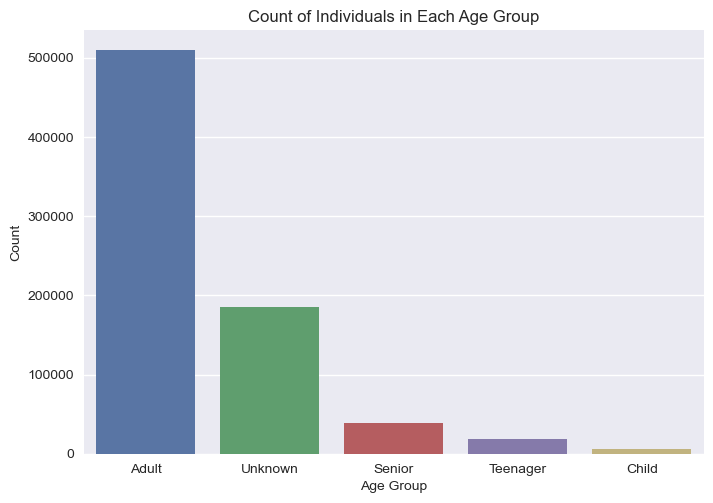

In [43]:
#Code Block 43
sns.countplot(x='Age Group', data=df_vict)
plt.xlabel('Age Group')
plt.ylabel('Count')
plt.title('Count of Individuals in Each Age Group')
plt.show()

In [44]:
#Code Block 44
df_victage = df_vict[df_vict["Vict Age"] > 0]

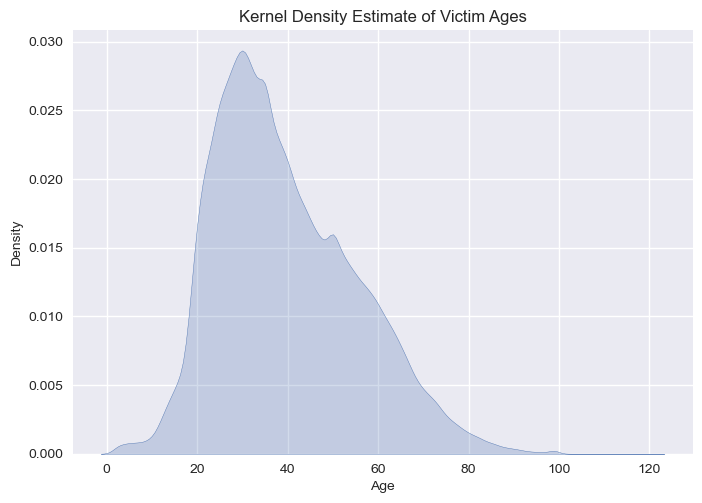

In [45]:
#Code Block 45
sns.kdeplot(df_victage['Vict Age'], fill=True)
plt.xlabel('Age')
plt.ylabel('Density')
plt.title('Kernel Density Estimate of Victim Ages')
plt.show()

<font color="blue">Summary:There are a lot of missing values in vict age variable, but we do notice that some of victims are Child and Teenagers.Also the victims who are older than 65 are being hurted and Adults age from 25-40 can be targets potentially, and the peek age is around 30 years old </font>

- drop the missing values in 'Vict Sex'and 'Vict Descent'

In [46]:
#Code Block 46
Descen_distribution = df_vict['Vict Descent'].value_counts()
print("Decent distribution of victims:")
print(Descen_distribution)

Decent distribution of victims:
H    232578
W    155242
B    108667
X     71785
O     59910
A     16531
K      4031
F      3155
C      2846
J      1062
V       766
I       722
Z       370
P       207
U       157
D        52
G        51
L        47
S        43
-         2
Name: Vict Descent, dtype: int64


<font color="blue"> Vict Descent : Descent Code: A - Other Asian; B - Black ;C - Chinese ;D - Cambodian; F - Filipino; 
             G - Guamanian;H - Hispanic/Latin/Mexican ;I - American Indian/Alaskan Native ;J - Japanese ;K - Korean ;
             L - Laotian ;O - Other; P - Pacific Islander ;S - Samoan; U - Hawaiian; V - Vietnamese ;W - White; X - Unknown;
             Z - Asian Indian</font>

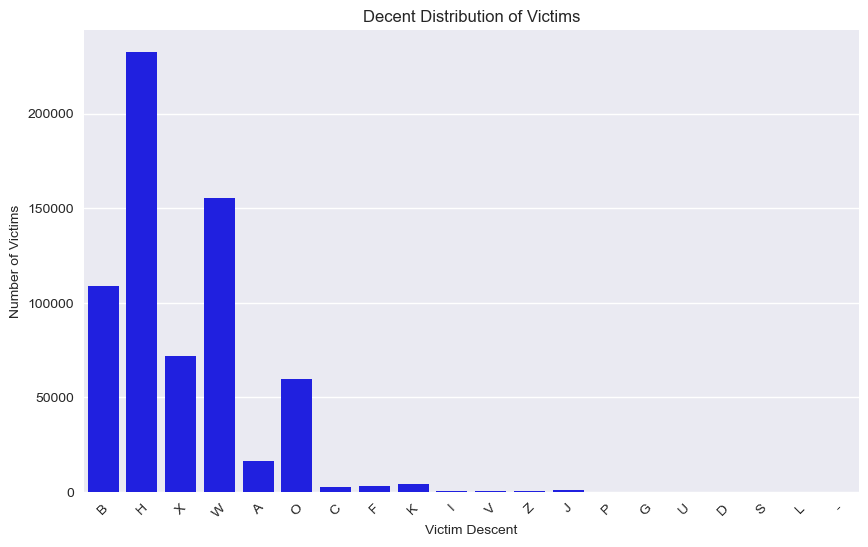

In [47]:
#Code Block 47
plt.figure(figsize=(10, 6))  # Optional: Set the figure size
sns.countplot(x='Vict Descent', data=df_vict, color='blue')
plt.xlabel('Victim Descent')
plt.ylabel('Number of Victims')
plt.title('Decent Distribution of Victims')
plt.xticks(rotation=45)  # Optional: Rotate x-axis labels for better readability
plt.show()

In [48]:
#Code Block 48
import plotly.express as px

# Assuming 'df_vict' contains the data with the column 'Vict Descent' representing victim descent

# Create the horizontal bar plot
fig = px.bar(df_vict['Vict Descent'].value_counts().reset_index(),
             x='Vict Descent',
             y='index',
             orientation='h',
             color='index',
             title='Decent Distribution of Victims',
             labels={'Vict Descent': 'Number of Victims', 'index': 'Victim Descent'},
             color_discrete_sequence=['blue'])

# Show the plot
fig.show()

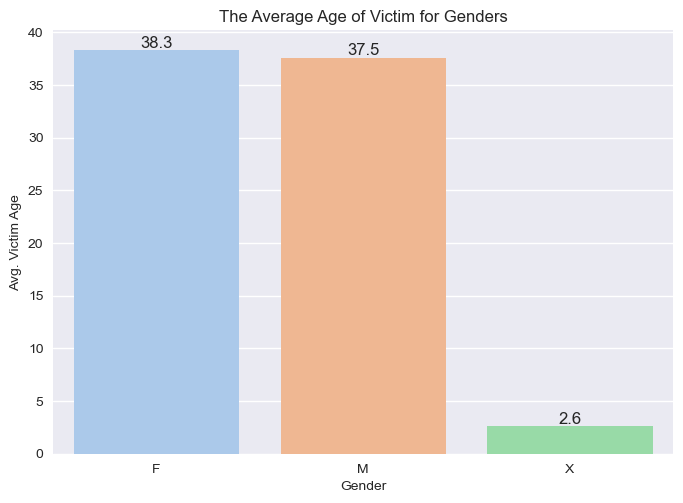

In [49]:
#Code Block 49
average_age_by_gender = df_vict.groupby('Vict Sex')['Vict Age'].mean().reset_index()

# Create the barplot
age_bar = sns.barplot(x='Vict Sex', y='Vict Age', data=average_age_by_gender, palette='pastel')

# Set labels and title
plt.xlabel('Gender')
plt.ylabel('Avg. Victim Age')
plt.title('The Average Age of Victim for Genders')
          
for index, value in enumerate(average_age_by_gender['Vict Age']):
    age_bar.text(index, value, f'{value:.1f}', ha='center', va='bottom', fontsize=12)


plt.show()

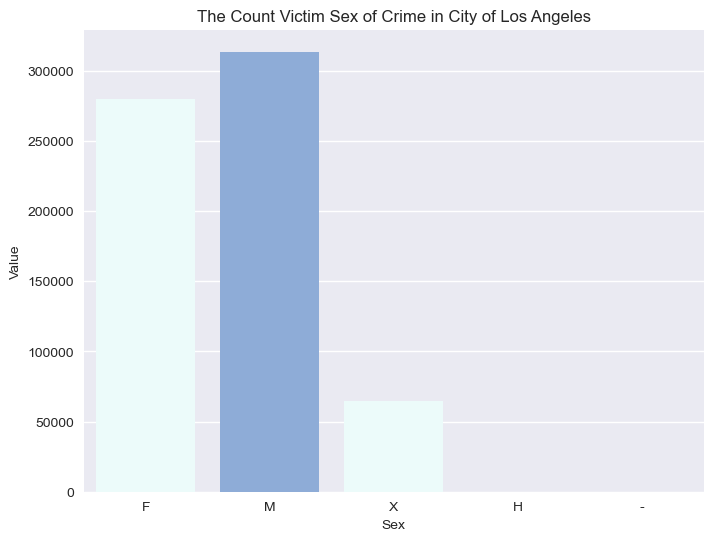

In [50]:
#Code Block 50
def bar_plot_column(data, col_name, colors, col_title, x_name, y_name):
    # Create the bar plot
    plt.figure(figsize=(8, 6))
    sns.countplot(x=col_name, data=data, palette=colors)
    
    # Set labels and title
    plt.xlabel(x_name)
    plt.ylabel(y_name)
    plt.title(col_title)
    # Show the plot 
    plt.show()

colors = ["#EAFDFC","#82AAE3"]
col_title = "The Count Victim Sex of Crime in City of Los Angeles"
x_name = "Sex"
y_name = "Value"

bar_plot_column(data=df_lacrime, col_name="Vict Sex", colors=colors, col_title=col_title, x_name=x_name, y_name=y_name)

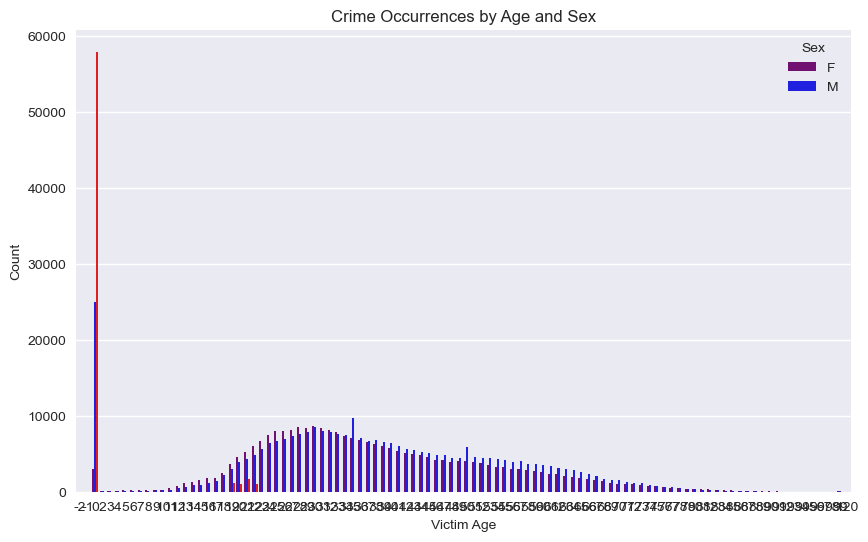

In [51]:
#Code Block 51
# Define custom colors for the plot
custom_palette = {"F": "purple", "M": "blue","X":"red"}

# Bar plot of crime occurrences by age and sex with custom colors
plt.figure(figsize=(10, 6))  # Optional: Set the figure size
sns.countplot(x='Vict Age', hue='Vict Sex', data=df_vict, palette=custom_palette)
plt.xlabel('Victim Age')
plt.ylabel('Count')
plt.title('Crime Occurrences by Age and Sex')
plt.legend(title='Sex', loc='upper right', labels=['F', 'M'])
plt.show()

### Summary:

### AREA, AREA NAME 

In [52]:
#Code Block 52
df_lacrime[['AREA','AREA NAME']].value_counts()

AREA  AREA NAME  
1     Central        50801
12    77th Street    47926
14    Pacific        44118
3     Southwest      42282
6     Hollywood      40354
18    Southeast      38817
20    Olympic        38409
13    Newton         37691
15    N Hollywood    37687
7     Wilshire       35761
2     Rampart        35197
8     West LA        34737
11    Northeast      32768
9     Van Nuys       32154
10    West Valley    31698
5     Harbor         31392
21    Topanga        30656
17    Devonshire     30641
19    Mission        30145
4     Hollenbeck     28477
16    Foothill       25430
dtype: int64

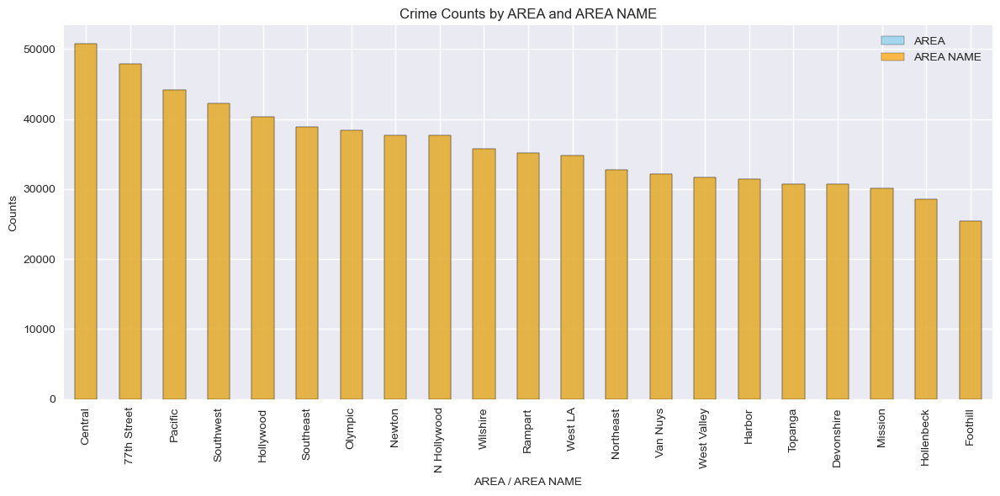

In [53]:
#Code Block 53
area_counts = df_lacrime['AREA'].value_counts()
area_name_counts = df_lacrime['AREA NAME'].value_counts()

# Create a figure and axis
fig, ax = plt.subplots(figsize=(12, 6))

# Plot the counts for 'AREA'
area_counts.plot(kind='bar', ax=ax, color='skyblue', edgecolor='black', alpha=0.7, label='AREA')

# Plot the counts for 'AREA NAME'
area_name_counts.plot(kind='bar', ax=ax, color='orange', edgecolor='black', alpha=0.7, label='AREA NAME')

# Set the title and labels
ax.set_title('Crime Counts by AREA and AREA NAME')
ax.set_xlabel('AREA / AREA NAME')
ax.set_ylabel('Counts')

# Show the legend
ax.legend()

# Show the plot
plt.tight_layout()
plt.show()
 





### Status, Status Description 

In [54]:
#Code Block 54
df_lacrime[['Status','Status Desc']].value_counts()

Status  Status Desc 
IC      Invest Cont     605801
AO      Adult Other      81519
AA      Adult Arrest     66147
JA      Juv Arrest        2391
JO      Juv Other         1280
CC      UNK                  3
dtype: int64

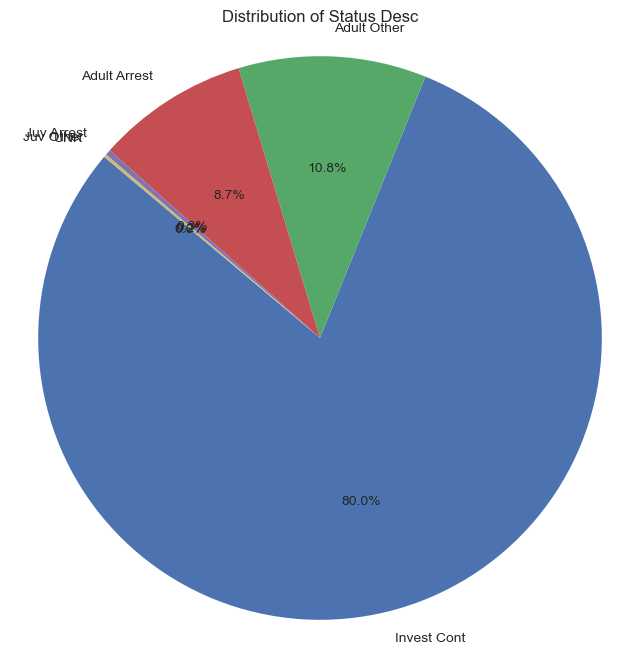

In [55]:
#Code Block 55
status_counts_df = df_lacrime[['Status', 'Status Desc']].value_counts().reset_index(name='Counts')

# Create a pie chart
plt.figure(figsize=(8, 8))
plt.pie(status_counts_df['Counts'], labels=status_counts_df['Status Desc'], autopct='%1.1f%%', startangle=140)

# Set the title
plt.title('Distribution of Status Desc')

# Show the pie chart
plt.axis('equal')  # Equal aspect ratio ensures that the pie chart is drawn as a circle.
plt.show()

<font color="blue"> Premis Desc(The type of structure, vehicle, or location where the crime took place)</font>

In [56]:
#Code Block 56
df_lacrime['Premis Desc']=df_lacrime['Premis Desc'].str.title()
df_lacrime['Premis Desc'].value_counts()

Street                                          190546
Single Family Dwelling                          128616
Multi-Unit Dwelling (Apartment, Duplex, Etc)     93146
Parking Lot                                      53594
Other Business                                   35336
                                                 ...  
Mta - Silver Line - Downtown Street Stops            2
Mta - Gold Line - Little Tokyo/Arts District         1
Tram/Streetcar(Boxlike Wag On Rails)*                1
Dept Of Defense Facility                             1
Harbor Frwy Station (Not Line Specific)              1
Name: Premis Desc, Length: 306, dtype: int64

- <span style="color:blue">**The top 10 places with higher probablity of crimes.**

In [57]:
#Code Block 57
Top10_premis = df_lacrime['Premis Desc'].value_counts().nlargest(10)
print(Top10_premis)

Street                                          190546
Single Family Dwelling                          128616
Multi-Unit Dwelling (Apartment, Duplex, Etc)     93146
Parking Lot                                      53594
Other Business                                   35336
Sidewalk                                         32753
Vehicle, Passenger/Truck                         22712
Garage/Carport                                   15295
Driveway                                         12674
Restaurant/Fast Food                              9603
Name: Premis Desc, dtype: int64


Text(0, 0.5, 'Counts')

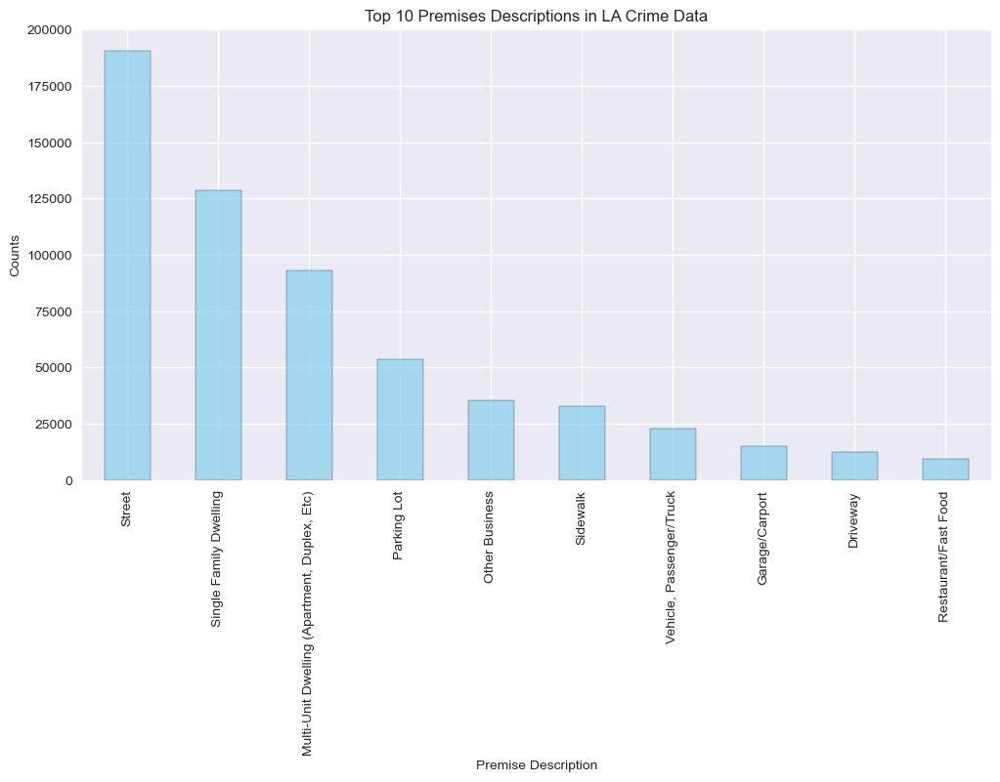

In [58]:
#Code Block 58
fig, ax = plt.subplots(figsize=(12, 6))

# Plot the bar chart
Top10_premis.plot(kind='bar', ax=ax, color='skyblue', edgecolor='black', alpha=0.7)

# Set the title and labels
ax.set_title(f'Top 10 Premises Descriptions in LA Crime Data')
ax.set_xlabel('Premise Description')
ax.set_ylabel('Counts')

In [59]:
#Code Block 59
premis_percentage = round((Top10_premis / len(df_lacrime)) * 100,2)
print(premis_percentage)

Street                                          25.17
Single Family Dwelling                          16.99
Multi-Unit Dwelling (Apartment, Duplex, Etc)    12.30
Parking Lot                                      7.08
Other Business                                   4.67
Sidewalk                                         4.33
Vehicle, Passenger/Truck                         3.00
Garage/Carport                                   2.02
Driveway                                         1.67
Restaurant/Fast Food                             1.27
Name: Premis Desc, dtype: float64


## Crime description 
- Crm Cd 1 : Indicates the crime committed. Crime Code 1 is the primary and most serious one. Crime Code 2, 3, and 4 are respectively less serious offenses. Lower crime class numbers are more serious.

In [60]:
#code block 60   
df_lacrime['Crm Cd'].value_counts()  #check Crm Cd

510    80913
624    60011
354    48874
330    46727
740    46379
       ...  
452        3
349        3
884        2
445        2
882        1
Name: Crm Cd, Length: 138, dtype: int64

In [61]:
#code block 61
df_lacrime["Crm Cd Desc"].describe()

count               757141
unique                 138
top       VEHICLE - STOLEN
freq                 80913
Name: Crm Cd Desc, dtype: object

In [62]:
#code block 62
df_lacrime[['Crm Cd','Crm Cd Desc']].value_counts()

Crm Cd  Crm Cd Desc                                            
510     VEHICLE - STOLEN                                           80913
624     BATTERY - SIMPLE ASSAULT                                   60011
354     THEFT OF IDENTITY                                          48874
330     BURGLARY FROM VEHICLE                                      46727
740     VANDALISM - FELONY ($400 & OVER, ALL CHURCH VANDALISMS)    46379
                                                                   ...  
452     PICKPOCKET, ATTEMPT                                            3
349     GRAND THEFT / AUTO REPAIR                                      3
445     DISHONEST EMPLOYEE ATTEMPTED THEFT                             2
884     FAILURE TO DISPERSE                                            2
882     INCITING A RIOT                                                1
Length: 138, dtype: int64

 - "Crm Cd" and"Crm Cd Desc" can map perfectly.

In [63]:
#code block 63
df_lacrime['Crm Cd Desc']=df_lacrime['Crm Cd Desc'].str.title()
df_lacrime['Crm Cd Desc'].value_counts()

Vehicle - Stolen                                           80913
Battery - Simple Assault                                   60011
Theft Of Identity                                          48874
Burglary From Vehicle                                      46727
Vandalism - Felony ($400 & Over, All Church Vandalisms)    46379
                                                           ...  
Pickpocket, Attempt                                            3
Grand Theft / Auto Repair                                      3
Failure To Disperse                                            2
Dishonest Employee Attempted Theft                             2
Inciting A Riot                                                1
Name: Crm Cd Desc, Length: 138, dtype: int64

In [64]:
#code block 64
Top20_Crm=df_lacrime['Crm Cd Desc'].value_counts().nlargest(20)
Top20_Crm

Vehicle - Stolen                                            80913
Battery - Simple Assault                                    60011
Theft Of Identity                                           48874
Burglary From Vehicle                                       46727
Vandalism - Felony ($400 & Over, All Church Vandalisms)     46379
Burglary                                                    46019
Assault With Deadly Weapon, Aggravated Assault              43431
Theft Plain - Petty ($950 & Under)                          38689
Intimate Partner - Simple Assault                           38170
Theft From Motor Vehicle - Petty ($950 & Under)             29467
Theft From Motor Vehicle - Grand ($950.01 And Over)         27822
Robbery                                                     25929
Theft-Grand ($950.01 & Over)Excpt,Guns,Fowl,Livestk,Prod    24315
Vandalism - Misdeameanor ($399 Or Under)                    20759
Shoplifting - Petty Theft ($950 & Under)                    16525
Criminal T

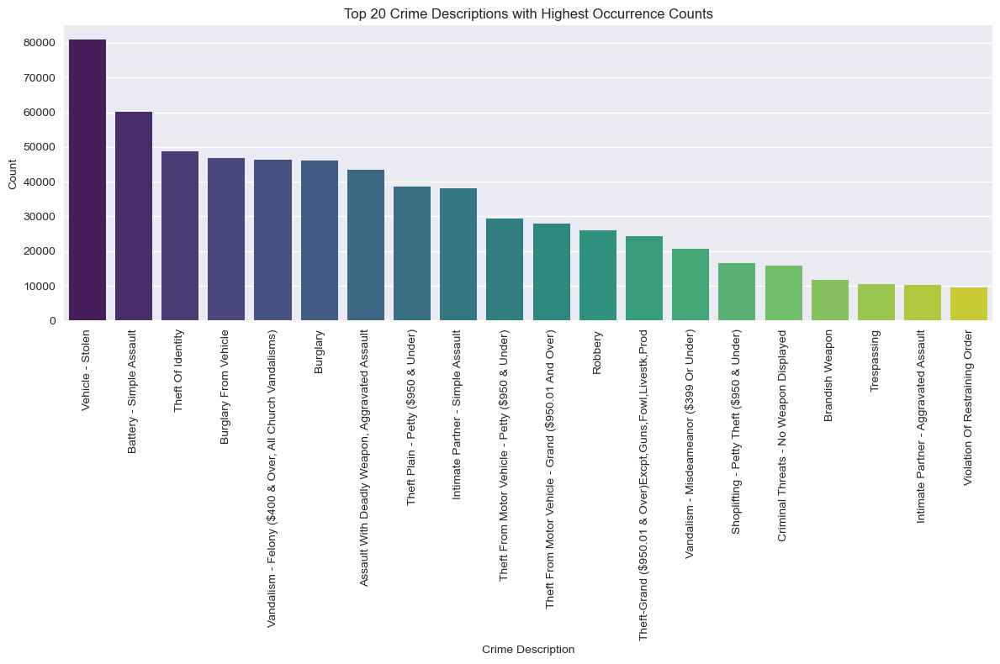

In [65]:
#code block 65
plt.figure(figsize=(12, 8))
sns.barplot(x=Top20_Crm.index, y=Top20_Crm.values, palette="viridis")
plt.xlabel('Crime Description')
plt.ylabel('Count')
plt.title('Top 20 Crime Descriptions with Highest Occurrence Counts')
plt.xticks(rotation=90)  # Optional: Rotate x-axis labels for better readability
plt.tight_layout()  # Optional: Adjust layout for better visualization
plt.show()

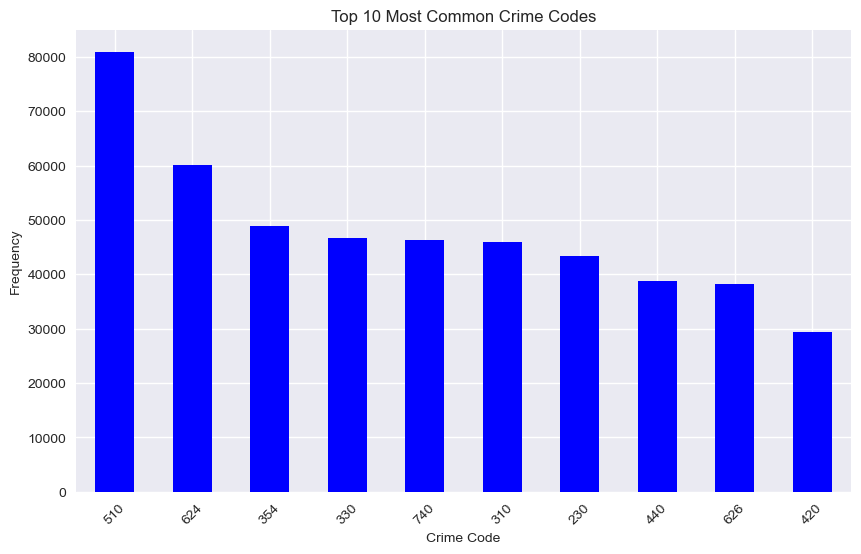

In [66]:
#code block 66
top10_crimecodes=df_lacrime['Crm Cd'].value_counts().nlargest(10)
# Create a bar plot
plt.figure(figsize=(10, 6))
top10_crimecodes.plot(kind='bar', color='blue')
plt.xlabel('Crime Code')
plt.ylabel('Frequency')
plt.title('Top 10 Most Common Crime Codes')
plt.xticks(rotation=45)
plt.show()

In [67]:
#code block 67
# Group by 'Crm Cd Desc' and count the occurrences of 'Crm Cd 1'
the_most_deadly_crime = df_lacrime.groupby('Crm Cd Desc').agg({"Crm Cd 1": "count"}).reset_index()
# Sort the DataFrame by the count of 'Crm Cd 1' in descending order and select the top 15
the_most_deadly_crime = the_most_deadly_crime.sort_values("Crm Cd 1", ascending=False).head(15)
# Display the result
print(the_most_deadly_crime)
 

                                           Crm Cd Desc  Crm Cd 1
132                                   Vehicle - Stolen     80913
4                             Battery - Simple Assault     60011
115                                  Theft Of Identity     48874
21                               Burglary From Vehicle     46726
129  Vandalism - Felony ($400 & Over, All Church Va...     46378
20                                            Burglary     46019
2       Assault With Deadly Weapon, Aggravated Assault     43431
117                 Theft Plain - Petty ($950 & Under)     38689
73                   Intimate Partner - Simple Assault     38170
113    Theft From Motor Vehicle - Petty ($950 & Under)     29467
112  Theft From Motor Vehicle - Grand ($950.01 And ...     27822
99                                             Robbery     25929
122  Theft-Grand ($950.01 & Over)Excpt,Guns,Fowl,Li...     24315
130           Vandalism - Misdeameanor ($399 Or Under)     20758
104           Shoplifting

- most of crimes committed are very serious crimes

---
<a href = "#99">Top</a>
<a id="1"></a>


 <h2 style="color:blue;"> Data Exploration </h2>   

<font color="blue" size="4"> Drop Columns that are not needed </font>

- Drop variables'Crm Cd 2','Crm Cd 3', 'Crm Cd 4','Cross Street' because of fewer entries for analysis.
- Drop variables'Crm Cd 1','Weapon Used Cd','Mocodes'for little relationship with objective of project.

In [68]:
#code block 68
df_lacrime.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 757141 entries, 0 to 757140
Data columns (total 34 columns):
 #   Column          Non-Null Count   Dtype         
---  ------          --------------   -----         
 0   DR_NO           757141 non-null  int64         
 1   Date Rptd       757141 non-null  datetime64[ns]
 2   DATE OCC        757141 non-null  datetime64[ns]
 3   TIME OCC        757141 non-null  object        
 4   AREA            757141 non-null  int64         
 5   AREA NAME       757141 non-null  object        
 6   Rpt Dist No     757141 non-null  int64         
 7   Part 1-2        757141 non-null  int64         
 8   Crm Cd          757141 non-null  int64         
 9   Crm Cd Desc     757141 non-null  object        
 10  Mocodes         653226 non-null  object        
 11  Vict Age        757141 non-null  int64         
 12  Vict Sex        658230 non-null  object        
 13  Vict Descent    658224 non-null  object        
 14  Premis Cd       757132 non-null  flo

In [69]:
#code block 69
df_lacrime=df_lacrime.drop(['Crm Cd 1','Crm Cd 2','Crm Cd 3', 'Crm Cd 4','Cross Street','Mocodes'], axis=1)

In [70]:
#code block 70
df_lacrime.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 757141 entries, 0 to 757140
Data columns (total 28 columns):
 #   Column          Non-Null Count   Dtype         
---  ------          --------------   -----         
 0   DR_NO           757141 non-null  int64         
 1   Date Rptd       757141 non-null  datetime64[ns]
 2   DATE OCC        757141 non-null  datetime64[ns]
 3   TIME OCC        757141 non-null  object        
 4   AREA            757141 non-null  int64         
 5   AREA NAME       757141 non-null  object        
 6   Rpt Dist No     757141 non-null  int64         
 7   Part 1-2        757141 non-null  int64         
 8   Crm Cd          757141 non-null  int64         
 9   Crm Cd Desc     757141 non-null  object        
 10  Vict Age        757141 non-null  int64         
 11  Vict Sex        658230 non-null  object        
 12  Vict Descent    658224 non-null  object        
 13  Premis Cd       757132 non-null  float64       
 14  Premis Desc     756699 non-null  obj

In [71]:
#code block 71
df_lacrime.head()

,DR_NO,Date Rptd,DATE OCC,TIME OCC,AREA,AREA NAME,Rpt Dist No,Part 1-2,Crm Cd,Crm Cd Desc,Vict Age,Vict Sex,Vict Descent,Premis Cd,Premis Desc,Weapon Used Cd,Weapon Desc,Status,Status Desc,LOCATION,LAT,LON,Year,Month,Date,DayofWeek,Time of Day,Season
0,10304468,2020-01-08,2020-01-08,22:30:00,3,Southwest,377,2,624,Battery - Simple Assault,36,F,B,501.0,Single Family Dwelling,400.0,"STRONG-ARM (HANDS, FIST, FEET OR BODILY FORCE)",AO,Adult Other,1100 W 39TH PL,34.0141,-118.2978,2020,1,8,Wednesday,Night,Winter
1,190101086,2020-01-02,2020-01-01,03:30:00,1,Central,163,2,624,Battery - Simple Assault,25,M,H,102.0,Sidewalk,500.0,UNKNOWN WEAPON/OTHER WEAPON,IC,Invest Cont,700 S HILL ST,34.0459,-118.2545,2020,1,1,Wednesday,Night,Winter
2,200110444,2020-04-14,2020-02-13,12:00:00,1,Central,155,2,845,Sex Offender Registrant Out Of Compliance,0,X,X,726.0,Police Facility,NaN,NaN,AA,Adult Arrest,200 E 6TH ST,34.0448,-118.2474,2020,2,13,Thursday,Afternoon,Winter
3,191501505,2020-01-01,2020-01-01,17:30:00,15,N Hollywood,1543,2,745,Vandalism - Misdeameanor ($399 Or Under),76,F,W,502.0,"Multi-Unit Dwelling (Apartment, Duplex, Etc)",NaN,NaN,IC,Invest Cont,5400 CORTEEN PL,34.1685,-118.4019,2020,1,1,Wednesday,Evening,Winter
4,191921269,2020-01-01,2020-01-01,04:15:00,19,Mission,1998,2,740,"Vandalism - Felony ($400 & Over, All Church Va...",31,X,X,409.0,Beauty Supply Store,NaN,NaN,IC,Invest Cont,14400 TITUS ST,34.2198,-118.4468,2020,1,1,Wednesday,Night,Winter


In [72]:
#code block 72
import folium
from folium.plugins import HeatMap 

# Get the minimum and maximum latitude and longitude from the dataset
min_lat, max_lat = df_lacrime['LAT'].min(), df_lacrime['LAT'].max()
min_lon, max_lon = df_lacrime['LON'].min(), df_lacrime['LON'].max()

# Calculate the center of the map
center_lat = (min_lat + max_lat) / 2
center_lon = (min_lon + max_lon) / 2

# Create a map centered on Los Angeles city
la_map = folium.Map(location=[center_lat, center_lon], zoom_start=10)

# List of unique areas in LA
unique_areas = df_lacrime['AREA NAME'].unique()

# Create separate heatmaps for each area
for area in unique_areas:
    area_data = df_lacrime[df_lacrime['AREA NAME'] == area]
    heat_data = [[row['LAT'], row['LON']] for _, row in area_data.iterrows()]
    HeatMap(heat_data, name=area).add_to(la_map)

# Add a layer control to toggle between different area heatmaps
folium.LayerControl().add_to(la_map)

# Display the map
la_map.save('crime_heatmap_by_areas.html')

In [73]:
#code block 73
la_map

In [74]:
#code block 74
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

                 AREA  Rpt Dist No  Part 1-2    Crm Cd  Vict Age  Premis Cd  \
AREA         1.000000     0.999045  0.009185 -0.000200  0.015757   0.003081   
Rpt Dist No  0.999045     1.000000  0.009074 -0.000287  0.015726   0.003015   
Part 1-2     0.009185     0.009074  1.000000  0.698756  0.196296   0.269642   
Crm Cd      -0.000200    -0.000287  0.698756  1.000000 -0.011797   0.103073   
Vict Age     0.015757     0.015726  0.196296 -0.011797  1.000000   0.192274   
Premis Cd    0.003081     0.003015  0.269642  0.103073  0.192274   1.000000   
LAT          0.021807     0.021576 -0.030895 -0.044061  0.000908  -0.007434   
LON         -0.009206    -0.009124  0.031260  0.044123  0.000393   0.008436   
Year        -0.013957    -0.013569 -0.003161 -0.027927 -0.010662   0.036449   
Month       -0.002908    -0.002890 -0.005282 -0.007505  0.000263  -0.010010   
Date        -0.005451    -0.005577 -0.047271  0.016500 -0.015434  -0.040763   

                  LAT       LON      Year     Month

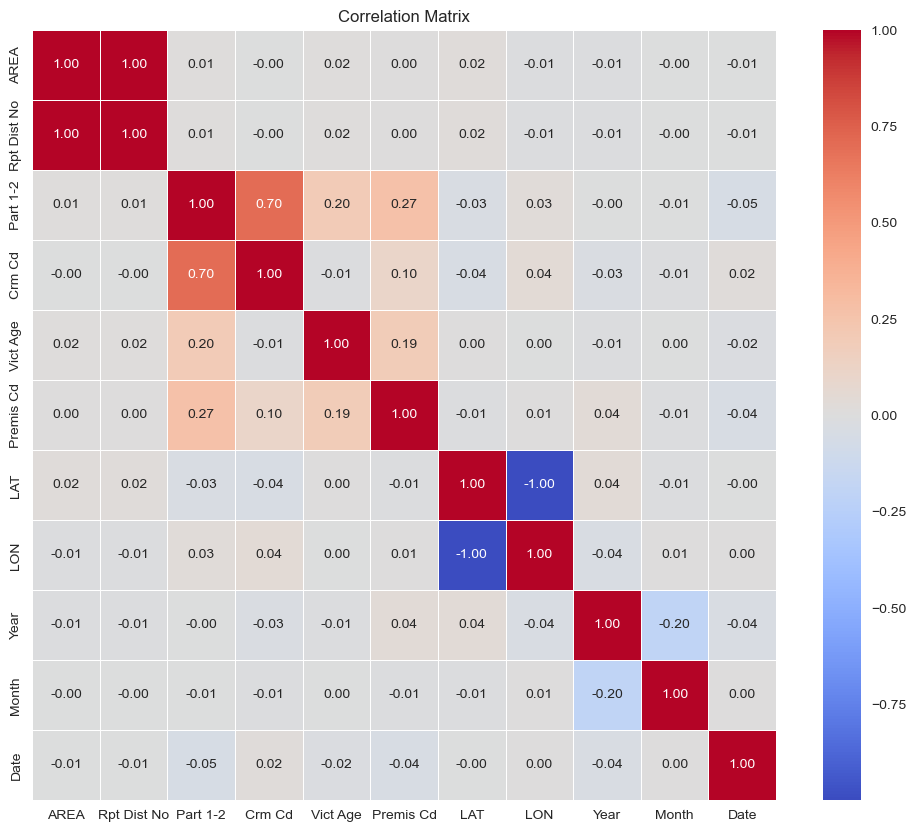

In [75]:
#code block 75
numeric_columns = df_lacrime[['AREA', 'Rpt Dist No', 'Part 1-2', 'Crm Cd', 'Vict Age', 'Premis Cd', 'LAT', 'LON', 'Year', 'Month',"Season", 'Date']]
# Calculate the correlation matrix
correlation_matrix = numeric_columns.corr()
# Print the correlation matrix
print(correlation_matrix)
# Visualize the correlation matrix using a heatmap
plt.figure(figsize=(12, 10))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f', linewidths=0.5)
plt.title('Correlation Matrix')
plt.show()

In [76]:
#code block 76
print(df_lacrime.columns)

Index(['DR_NO', 'Date Rptd', 'DATE OCC', 'TIME OCC', 'AREA', 'AREA NAME',
       'Rpt Dist No', 'Part 1-2', 'Crm Cd', 'Crm Cd Desc', 'Vict Age',
       'Vict Sex', 'Vict Descent', 'Premis Cd', 'Premis Desc',
       'Weapon Used Cd', 'Weapon Desc', 'Status', 'Status Desc', 'LOCATION',
       'LAT', 'LON', 'Year', 'Month', 'Date', 'DayofWeek', 'Time of Day',
       'Season'],
      dtype='object')


In [77]:
#code block 77
df_lacrime.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 757141 entries, 0 to 757140
Data columns (total 28 columns):
 #   Column          Non-Null Count   Dtype         
---  ------          --------------   -----         
 0   DR_NO           757141 non-null  int64         
 1   Date Rptd       757141 non-null  datetime64[ns]
 2   DATE OCC        757141 non-null  datetime64[ns]
 3   TIME OCC        757141 non-null  object        
 4   AREA            757141 non-null  int64         
 5   AREA NAME       757141 non-null  object        
 6   Rpt Dist No     757141 non-null  int64         
 7   Part 1-2        757141 non-null  int64         
 8   Crm Cd          757141 non-null  int64         
 9   Crm Cd Desc     757141 non-null  object        
 10  Vict Age        757141 non-null  int64         
 11  Vict Sex        658230 non-null  object        
 12  Vict Descent    658224 non-null  object        
 13  Premis Cd       757132 non-null  float64       
 14  Premis Desc     756699 non-null  obj

In [78]:
#code block 78
df_crime=df_lacrime[['AREA', 'AREA NAME',"DATE OCC",
       'Crm Cd', 'Crm Cd Desc', 'Vict Age','Vict Sex', 'Vict Descent', 'Premis Cd', 'Premis Desc', 
       'Status', 'Status Desc', 'LAT', 'LON', 'Year', 'Month',
       'Date', 'DayofWeek', 'Time of Day', 'Season']]

In [79]:
#code block 79
df_crime.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 757141 entries, 0 to 757140
Data columns (total 20 columns):
 #   Column        Non-Null Count   Dtype         
---  ------        --------------   -----         
 0   AREA          757141 non-null  int64         
 1   AREA NAME     757141 non-null  object        
 2   DATE OCC      757141 non-null  datetime64[ns]
 3   Crm Cd        757141 non-null  int64         
 4   Crm Cd Desc   757141 non-null  object        
 5   Vict Age      757141 non-null  int64         
 6   Vict Sex      658230 non-null  object        
 7   Vict Descent  658224 non-null  object        
 8   Premis Cd     757132 non-null  float64       
 9   Premis Desc   756699 non-null  object        
 10  Status        757141 non-null  object        
 11  Status Desc   757141 non-null  object        
 12  LAT           757141 non-null  float64       
 13  LON           757141 non-null  float64       
 14  Year          757141 non-null  int64         
 15  Month         757

In [80]:
#code block 80
df_crime=df_crime.dropna()
df_crime.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 657791 entries, 0 to 757140
Data columns (total 20 columns):
 #   Column        Non-Null Count   Dtype         
---  ------        --------------   -----         
 0   AREA          657791 non-null  int64         
 1   AREA NAME     657791 non-null  object        
 2   DATE OCC      657791 non-null  datetime64[ns]
 3   Crm Cd        657791 non-null  int64         
 4   Crm Cd Desc   657791 non-null  object        
 5   Vict Age      657791 non-null  int64         
 6   Vict Sex      657791 non-null  object        
 7   Vict Descent  657791 non-null  object        
 8   Premis Cd     657791 non-null  float64       
 9   Premis Desc   657791 non-null  object        
 10  Status        657791 non-null  object        
 11  Status Desc   657791 non-null  object        
 12  LAT           657791 non-null  float64       
 13  LON           657791 non-null  float64       
 14  Year          657791 non-null  int64         
 15  Month         657

### Dummy variables

In [81]:
#code block 81
dummies_Areaname=pd.get_dummies(df_crime["AREA NAME"],prefix="Area",drop_first=False)
dummies_Month=pd.get_dummies(df_crime["Month"],prefix="Month",drop_first=False)
dummies_Timeofday=pd.get_dummies(df_crime['Time of Day'], prefix='Time', drop_first=False)
dummies_Victdescent=pd.get_dummies(df_crime["Vict Descent"],prefix="Desc",drop_first=False)

In [82]:
#code block 82
df_crime=pd.concat([df_crime,dummies_Victdescent,dummies_Areaname,dummies_Month,dummies_Timeofday],axis=1)

In [83]:
#code block 83
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
df_crime['Vict Sex'] = le.fit_transform(df_crime['Vict Sex'])

In [84]:
#code block 84
df_crime["DayofWeek"] = df_crime["DATE OCC"].dt.dayofweek
df_crime.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 657791 entries, 0 to 757140
Data columns (total 77 columns):
 #   Column            Non-Null Count   Dtype         
---  ------            --------------   -----         
 0   AREA              657791 non-null  int64         
 1   AREA NAME         657791 non-null  object        
 2   DATE OCC          657791 non-null  datetime64[ns]
 3   Crm Cd            657791 non-null  int64         
 4   Crm Cd Desc       657791 non-null  object        
 5   Vict Age          657791 non-null  int64         
 6   Vict Sex          657791 non-null  int32         
 7   Vict Descent      657791 non-null  object        
 8   Premis Cd         657791 non-null  float64       
 9   Premis Desc       657791 non-null  object        
 10  Status            657791 non-null  object        
 11  Status Desc       657791 non-null  object        
 12  LAT               657791 non-null  float64       
 13  LON               657791 non-null  float64       
 14  Year

In [85]:
#code block 85
df_crime.head()

,AREA,AREA NAME,DATE OCC,Crm Cd,Crm Cd Desc,Vict Age,Vict Sex,Vict Descent,Premis Cd,Premis Desc,Status,Status Desc,LAT,LON,Year,Month,Date,DayofWeek,Time of Day,Season,Desc_-,Desc_A,Desc_B,Desc_C,Desc_D,Desc_F,Desc_G,Desc_H,Desc_I,Desc_J,Desc_K,Desc_L,Desc_O,Desc_P,Desc_S,Desc_U,Desc_V,Desc_W,Desc_X,Desc_Z,Area_77th Street,Area_Central,Area_Devonshire,Area_Foothill,Area_Harbor,Area_Hollenbeck,Area_Hollywood,Area_Mission,Area_N Hollywood,Area_Newton,Area_Northeast,Area_Olympic,Area_Pacific,Area_Rampart,Area_Southeast,Area_Southwest,Area_Topanga,Area_Van Nuys,Area_West LA,Area_West Valley,Area_Wilshire,Month_1,Month_2,Month_3,Month_4,Month_5,Month_6,Month_7,Month_8,Month_9,Month_10,Month_11,Month_12,Time_Afternoon,Time_Evening,Time_Morning,Time_Night
0,3,Southwest,2020-01-08,624,Battery - Simple Assault,36,1,B,501.0,Single Family Dwelling,AO,Adult Other,34.0141,-118.2978,2020,1,8,2,Night,Winter,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
1,1,Central,2020-01-01,624,Battery - Simple Assault,25,3,H,102.0,Sidewalk,IC,Invest Cont,34.0459,-118.2545,2020,1,1,2,Night,Winter,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
2,1,Central,2020-02-13,845,Sex Offender Registrant Out Of Compliance,0,4,X,726.0,Police Facility,AA,Adult Arrest,34.0448,-118.2474,2020,2,13,3,Afternoon,Winter,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0
3,15,N Hollywood,2020-01-01,745,Vandalism - Misdeameanor ($399 Or Under),76,1,W,502.0,"Multi-Unit Dwelling (Apartment, Duplex, Etc)",IC,Invest Cont,34.1685,-118.4019,2020,1,1,2,Evening,Winter,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0
4,19,Mission,2020-01-01,740,"Vandalism - Felony ($400 & Over, All Church Va...",31,4,X,409.0,Beauty Supply Store,IC,Invest Cont,34.2198,-118.4468,2020,1,1,2,Night,Winter,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1


In [86]:
#code block 86
df_crime['Monday'] = 0
df_crime['Tuesday'] = 0
df_crime['Wednesday'] = 0
df_crime['Thursday'] = 0
df_crime['Friday'] = 0
df_crime['Saturday'] = 0
df_crime['Sunday'] = 0
df_crime.loc[df_crime['DayofWeek'] == 0, 'Monday'] = 1
df_crime.loc[df_crime['DayofWeek'] == 1, 'Tuesday'] = 1
df_crime.loc[df_crime['DayofWeek'] == 2, 'Wednesday'] = 1
df_crime.loc[df_crime['DayofWeek'] == 3, 'Thursday'] = 1
df_crime.loc[df_crime['DayofWeek'] == 4, 'Friday'] = 1
df_crime.loc[df_crime['DayofWeek'] == 5, 'Saturday'] = 1
df_crime.loc[df_crime['DayofWeek'] == 6, 'Sunday'] = 1


In [87]:
#code block 87
df_crime=df_crime.drop(["AREA", "AREA NAME","Premis Cd","Premis Desc","Status","Status Desc",
                       "Month","Date","DayofWeek","Time of Day","Season","DATE OCC","Crm Cd","Vict Descent"],axis=1)

In [88]:
#code block 88
df_crime.head(2)

,Crm Cd Desc,Vict Age,Vict Sex,LAT,LON,Year,Desc_-,Desc_A,Desc_B,Desc_C,Desc_D,Desc_F,Desc_G,Desc_H,Desc_I,Desc_J,Desc_K,Desc_L,Desc_O,Desc_P,Desc_S,Desc_U,Desc_V,Desc_W,Desc_X,Desc_Z,Area_77th Street,Area_Central,Area_Devonshire,Area_Foothill,Area_Harbor,Area_Hollenbeck,Area_Hollywood,Area_Mission,Area_N Hollywood,Area_Newton,Area_Northeast,Area_Olympic,Area_Pacific,Area_Rampart,Area_Southeast,Area_Southwest,Area_Topanga,Area_Van Nuys,Area_West LA,Area_West Valley,Area_Wilshire,Month_1,Month_2,Month_3,Month_4,Month_5,Month_6,Month_7,Month_8,Month_9,Month_10,Month_11,Month_12,Time_Afternoon,Time_Evening,Time_Morning,Time_Night,Monday,Tuesday,Wednesday,Thursday,Friday,Saturday,Sunday
0,Battery - Simple Assault,36,1,34.0141,-118.2978,2020,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0
1,Battery - Simple Assault,25,3,34.0459,-118.2545,2020,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0


In [89]:
#code block 89
df_crime_corr = round(df_crime.corr(), 3)
df_crime_corr

,Vict Age,Vict Sex,LAT,LON,Year,Desc_-,Desc_A,Desc_B,Desc_C,Desc_D,Desc_F,Desc_G,Desc_H,Desc_I,Desc_J,Desc_K,Desc_L,Desc_O,Desc_P,Desc_S,Desc_U,Desc_V,Desc_W,Desc_X,Desc_Z,Area_77th Street,Area_Central,Area_Devonshire,Area_Foothill,Area_Harbor,Area_Hollenbeck,Area_Hollywood,Area_Mission,Area_N Hollywood,Area_Newton,Area_Northeast,Area_Olympic,Area_Pacific,Area_Rampart,Area_Southeast,Area_Southwest,Area_Topanga,Area_Van Nuys,Area_West LA,Area_West Valley,Area_Wilshire,Month_1,Month_2,Month_3,Month_4,Month_5,Month_6,Month_7,Month_8,Month_9,Month_10,Month_11,Month_12,Time_Afternoon,Time_Evening,Time_Morning,Time_Night,Monday,Tuesday,Wednesday,Thursday,Friday,Saturday,Sunday
Vict Age,1.000,-0.293,0.010,-0.009,-0.013,-0.001,0.060,0.102,0.002,-0.001,0.019,0.002,0.072,0.003,0.019,0.029,0.000,0.012,0.004,0.000,-0.004,0.001,0.172,-0.522,0.002,0.001,-0.023,0.005,0.021,-0.009,-0.015,-0.035,0.019,-0.009,-0.028,-0.005,-0.019,0.003,-0.025,-0.004,0.012,0.055,0.037,0.018,0.018,-0.001,-0.000,-0.002,-0.002,-0.003,-0.007,0.001,0.006,0.002,0.003,-0.001,0.003,0.004,0.021,-0.015,0.049,-0.053,0.004,0.001,0.004,0.004,-0.003,-0.002,-0.008
Vict Sex,-0.293,1.000,-0.003,0.004,-0.000,-0.001,-0.031,-0.146,-0.012,-0.003,-0.015,-0.002,-0.169,-0.003,-0.008,-0.012,-0.005,0.014,-0.006,-0.001,-0.001,-0.009,-0.044,0.507,-0.000,-0.044,0.039,0.022,-0.022,-0.001,-0.006,0.036,-0.029,-0.006,-0.014,0.017,0.017,0.031,0.010,-0.048,-0.017,-0.012,-0.013,0.025,-0.013,0.017,-0.001,-0.004,0.001,0.006,0.006,0.003,-0.002,-0.001,-0.005,-0.004,-0.001,-0.002,-0.006,0.019,-0.024,0.012,0.002,0.003,0.002,-0.000,0.005,-0.004,-0.008
LAT,0.010,-0.003,1.000,-0.999,0.040,0.000,0.005,-0.008,0.003,0.000,0.003,-0.002,-0.002,0.000,0.001,0.001,0.000,0.006,0.001,0.000,0.001,0.001,0.012,-0.014,0.002,-0.012,-0.008,0.018,0.016,-0.028,-0.003,-0.020,0.015,0.014,-0.006,0.010,-0.002,-0.015,-0.002,-0.019,0.000,0.021,0.014,0.005,0.019,-0.004,0.009,0.008,0.005,-0.003,-0.002,-0.002,-0.011,-0.010,0.001,0.000,0.002,0.001,-0.020,0.011,-0.011,0.019,0.002,0.000,0.001,0.000,-0.000,-0.002,-0.002
LON,-0.009,0.004,-0.999,1.000,-0.039,-0.000,-0.004,0.000,-0.003,-0.000,-0.002,0.003,0.004,-0.000,-0.002,-0.001,-0.000,-0.003,-0.001,-0.000,-0.001,-0.000,-0.008,0.011,-0.002,0.001,0.008,-0.005,-0.001,-0.002,0.005,0.024,0.001,-0.003,0.002,-0.003,0.003,0.002,0.003,0.006,-0.005,-0.016,-0.006,-0.010,-0.012,0.003,-0.009,-0.008,-0.005,0.003,0.002,0.002,0.011,0.010,-0.001,-0.000,-0.001,-0.001,0.020,-0.011,0.010,-0.019,-0.002,-0.000,-0.001,-0.000,0.001,0.002,0.001
Year,-0.013,-0.000,0.040,-0.039,1.000,0.003,0.001,-0.003,0.019,0.002,0.015,-0.001,0.001,0.009,0.010,0.007,0.003,-0.005,0.003,0.001,0.005,0.007,-0.022,0.023,0.007,-0.008,0.025,0.003,-0.005,-0.013,-0.005,-0.002,-0.006,-0.006,0.005,0.002,0.005,-0.007,0.007,-0.004,-0.001,0.001,-0.000,-0.005,0.006,0.003,0.054,0.055,0.070,0.075,0.062,0.058,-0.044,-0.079,-0.075,-0.076,-0.076,-0.072,-0.006,-0.009,0.017,-0.002,-0.002,-0.001,-0.003,0.001,0.002,0.000,0.002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Wednesday,0.004,0.002,0.001,-0.001,-0.003,-0.001,0.000,-0.002,-0.000,-0.001,0.002,0.000,-0.008,-0.001,-0.001,0.001,0.000,0.004,-0.001,-0.001,0.000,0.002,0.003,0.006,-0.002,-0.001,-0.002,0.002,0.001,-0.000,-0.001,-0.005,0.000,0.003,-0.001,0.001,0.001,0.002,-0.002,-0.002,0.001,0.002,0.002,0.002,0.002,-0.002,-0.000,0.002,0.014,-0.006,-0.009,0.006,-0.006,-0.004,0.007,-0.018,0.004,0.009,0.008,0.003,0.011,-0.021,-0.166,-0.162,1.000,-0.165,-0.172,-0.168,-0.164
Thursday,0.004,-0.000,0.000,-0.000,0.001,0.004,-0.001,-0.001,-0.000,0.002,0.002,-0.001,-0.004,-0.001,0.001,0.000,0.002,0.001,0.001,0.003,-0.001,-0.000,0.004,0.002,-0.001,0.000,-0.002,0.002,0.000,-0.001,-0.002,-0.001,0.001,-0.001,-0.001,-0.001,0.000,-0.001,-0.000,0.003,0.001,0.002,0.000,0.003,0.002,-0.001,

In [90]:
#code block 90
df_crime['Target_Burglary'] = df_crime['Crm Cd Desc'].apply(lambda x: 1 if x == 'Burglary' else 0)
# Separate features and target variable
df_crime.head()

,Crm Cd Desc,Vict Age,Vict Sex,LAT,LON,Year,Desc_-,Desc_A,Desc_B,Desc_C,Desc_D,Desc_F,Desc_G,Desc_H,Desc_I,Desc_J,Desc_K,Desc_L,Desc_O,Desc_P,Desc_S,Desc_U,Desc_V,Desc_W,Desc_X,Desc_Z,Area_77th Street,Area_Central,Area_Devonshire,Area_Foothill,Area_Harbor,Area_Hollenbeck,Area_Hollywood,Area_Mission,Area_N Hollywood,Area_Newton,Area_Northeast,Area_Olympic,Area_Pacific,Area_Rampart,Area_Southeast,Area_Southwest,Area_Topanga,Area_Van Nuys,Area_West LA,Area_West Valley,Area_Wilshire,Month_1,Month_2,Month_3,Month_4,Month_5,Month_6,Month_7,Month_8,Month_9,Month_10,Month_11,Month_12,Time_Afternoon,Time_Evening,Time_Morning,Time_Night,Monday,Tuesday,Wednesday,Thursday,Friday,Saturday,Sunday,Target_Burglary
0,Battery - Simple Assault,36,1,34.0141,-118.2978,2020,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0
1,Battery - Simple Assault,25,3,34.0459,-118.2545,2020,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0
2,Sex Offender Registrant Out Of Compliance,0,4,34.0448,-118.2474,2020,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0
3,Vandalism - Misdeameanor ($399 Or Under),76,1,34.1685,-118.4019,2020,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0
4,"Vandalism - Felony ($400 & Over, All Church Va...",31,4,34.2198,-118.4468,2020,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0


<div style="background-color:#3b528b;  color:white; padding:20px">

<a href="#99" style="color:white;"> Top ⬆️</a>

<a id="3"></a>

<h2> Modeling/ Classification with Big Dataset:🎯</h2>
</div>

    -  Logistic Regression
    -  Decison Tree
    -  Random Forest
    

## Create the datasets

### Create the X and y datasets

In [91]:
#code block 91
df_burg=df_crime.copy()

In [92]:
#code block 92
X = df_burg.drop(columns=['Crm Cd Desc', 'Target_Burglary'])
y = df_burg['Target_Burglary']

In [93]:
#code block 93
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import accuracy_score, classification_report

#### Create the split data (X_train, X_test, y_train, y_test)

In [94]:
#code block 94
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3, random_state = 42)

#### Modeling

In [95]:
#code block 95
lasso_model = LogisticRegression(penalty='l1', solver='liblinear', max_iter=1000)  
lasso_model.fit(X_train, y_train)

# Make predictions on the test set
y_pred = lasso_model.predict(X_test)

# Evaluate the model
accuracy_lasso = accuracy_score(y_test, y_pred)
print("Accuracy:", accuracy_lasso)

report = classification_report(y_test, y_pred)
print("Classification Report:")
print(report)

Accuracy: 0.9305050218406997
Classification Report:
              precision    recall  f1-score   support

           0       0.93      1.00      0.96    183624
           1       0.00      0.00      0.00     13714

    accuracy                           0.93    197338
   macro avg       0.47      0.50      0.48    197338
weighted avg       0.87      0.93      0.90    197338



In [96]:
#code block 96
#Logistic Regression
logreg = LogisticRegression()
logreg.fit(X_train, y_train)
y_pred_logreg = logreg.predict(X_test)
accuracy_logreg = accuracy_score(y_test, y_pred_logreg)
print("Logistic Regression Accuracy:", accuracy_logreg)
print(classification_report(y_test, y_pred_logreg))


Logistic Regression Accuracy: 0.9305050218406997
              precision    recall  f1-score   support

           0       0.93      1.00      0.96    183624
           1       0.00      0.00      0.00     13714

    accuracy                           0.93    197338
   macro avg       0.47      0.50      0.48    197338
weighted avg       0.87      0.93      0.90    197338



In [97]:
#code block 97 
#Random Forest Classifier
rf_classifier = RandomForestClassifier()
rf_classifier.fit(X_train, y_train)
y_pred_rf = rf_classifier.predict(X_test)
accuracy_rf = accuracy_score(y_test, y_pred_rf)
print("Random Forest Accuracy:", accuracy_rf)
print(classification_report(y_test, y_pred_rf))


Random Forest Accuracy: 0.9299476025904793
              precision    recall  f1-score   support

           0       0.93      1.00      0.96    183624
           1       0.47      0.05      0.10     13714

    accuracy                           0.93    197338
   macro avg       0.70      0.53      0.53    197338
weighted avg       0.90      0.93      0.90    197338



<div style="background-color:#3b528b;  color:white; padding:20px">

<a href="#99" style="color:white;"> Top ⬆️</a>

<a id="4"></a>

<h2> Modeling/ Classification with Tuned Dataset:🎯</h2>
</div>

    -  Logistic Regression
    -  Decison Tree
    -  Random Forest


<font color="blue" size="5">Tune the final data</font>

#### There are too many entries in the final model, it is time consuming to run the models. So data needs further cleansed to get more insights.

In [98]:
#code block 98
df_lacrime=df_lacrime.dropna()
df_lacrime.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 262785 entries, 0 to 757138
Data columns (total 28 columns):
 #   Column          Non-Null Count   Dtype         
---  ------          --------------   -----         
 0   DR_NO           262785 non-null  int64         
 1   Date Rptd       262785 non-null  datetime64[ns]
 2   DATE OCC        262785 non-null  datetime64[ns]
 3   TIME OCC        262785 non-null  object        
 4   AREA            262785 non-null  int64         
 5   AREA NAME       262785 non-null  object        
 6   Rpt Dist No     262785 non-null  int64         
 7   Part 1-2        262785 non-null  int64         
 8   Crm Cd          262785 non-null  int64         
 9   Crm Cd Desc     262785 non-null  object        
 10  Vict Age        262785 non-null  int64         
 11  Vict Sex        262785 non-null  object        
 12  Vict Descent    262785 non-null  object        
 13  Premis Cd       262785 non-null  float64       
 14  Premis Desc     262785 non-null  obj

In [99]:
#code block 99
df_crime1=df_lacrime.copy()

In [100]:
#code block 100
df_crime1["DayofWeek"] = df_crime1["DATE OCC"].dt.dayofweek

In [101]:
#code block 101
dummies_Areaname=pd.get_dummies(df_crime1["AREA NAME"],prefix="Area",drop_first=False)
dummies_Month=pd.get_dummies(df_crime1["Month"],prefix="Month",drop_first=False)
dummies_Timeofday=pd.get_dummies(df_crime1['Time of Day'], prefix='Time', drop_first=False)
dummies_Victdescent=pd.get_dummies(df_crime1["Vict Descent"],prefix="Desc",drop_first=False)
dummies_DayofWeek=pd.get_dummies(df_crime1["DayofWeek"],prefix="Day",drop_first=False)

In [102]:
#code block 102
df_crime1=pd.concat([df_crime1,dummies_Victdescent,dummies_Areaname,dummies_Month,dummies_DayofWeek,dummies_Timeofday],axis=1)

In [103]:
#code block 103
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
df_crime['Vict Sex'] = le.fit_transform(df_crime['Vict Sex'])

In [104]:
#code block 104
df_crime1.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 262785 entries, 0 to 757138
Data columns (total 91 columns):
 #   Column            Non-Null Count   Dtype         
---  ------            --------------   -----         
 0   DR_NO             262785 non-null  int64         
 1   Date Rptd         262785 non-null  datetime64[ns]
 2   DATE OCC          262785 non-null  datetime64[ns]
 3   TIME OCC          262785 non-null  object        
 4   AREA              262785 non-null  int64         
 5   AREA NAME         262785 non-null  object        
 6   Rpt Dist No       262785 non-null  int64         
 7   Part 1-2          262785 non-null  int64         
 8   Crm Cd            262785 non-null  int64         
 9   Crm Cd Desc       262785 non-null  object        
 10  Vict Age          262785 non-null  int64         
 11  Vict Sex          262785 non-null  object        
 12  Vict Descent      262785 non-null  object        
 13  Premis Cd         262785 non-null  float64       
 14  Prem

## Create the datasets

In [105]:
#code block 105
df_final=df_crime1.copy()

In [106]:
#code block 106
df_final.columns         

Index(['DR_NO', 'Date Rptd', 'DATE OCC', 'TIME OCC', 'AREA', 'AREA NAME',
       'Rpt Dist No', 'Part 1-2', 'Crm Cd', 'Crm Cd Desc', 'Vict Age',
       'Vict Sex', 'Vict Descent', 'Premis Cd', 'Premis Desc',
       'Weapon Used Cd', 'Weapon Desc', 'Status', 'Status Desc', 'LOCATION',
       'LAT', 'LON', 'Year', 'Month', 'Date', 'DayofWeek', 'Time of Day',
       'Season', 'Desc_A', 'Desc_B', 'Desc_C', 'Desc_D', 'Desc_F', 'Desc_G',
       'Desc_H', 'Desc_I', 'Desc_J', 'Desc_K', 'Desc_L', 'Desc_O', 'Desc_P',
       'Desc_S', 'Desc_U', 'Desc_V', 'Desc_W', 'Desc_X', 'Desc_Z',
       'Area_77th Street', 'Area_Central', 'Area_Devonshire', 'Area_Foothill',
       'Area_Harbor', 'Area_Hollenbeck', 'Area_Hollywood', 'Area_Mission',
       'Area_N Hollywood', 'Area_Newton', 'Area_Northeast', 'Area_Olympic',
       'Area_Pacific', 'Area_Rampart', 'Area_Southeast', 'Area_Southwest',
       'Area_Topanga', 'Area_Van Nuys', 'Area_West LA', 'Area_West Valley',
       'Area_Wilshire', 'Month_1', 'Mon

In [107]:
#code block 107
df_final=df_crime1.drop(['DR_NO','Date Rptd','DATE OCC','TIME OCC', 'AREA', 'AREA NAME','Rpt Dist No', 'Part 1-2', 'Crm Cd',
                   'Premis Desc','Status', 'Status Desc','LOCATION', 'Date',
                         'Time of Day', 'Season','Vict Sex','Vict Descent','Weapon Desc'],axis=1)

In [108]:
#code block 108
df_final.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 262785 entries, 0 to 757138
Data columns (total 72 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   Crm Cd Desc       262785 non-null  object 
 1   Vict Age          262785 non-null  int64  
 2   Premis Cd         262785 non-null  float64
 3   Weapon Used Cd    262785 non-null  float64
 4   LAT               262785 non-null  float64
 5   LON               262785 non-null  float64
 6   Year              262785 non-null  int64  
 7   Month             262785 non-null  int64  
 8   DayofWeek         262785 non-null  int64  
 9   Desc_A            262785 non-null  uint8  
 10  Desc_B            262785 non-null  uint8  
 11  Desc_C            262785 non-null  uint8  
 12  Desc_D            262785 non-null  uint8  
 13  Desc_F            262785 non-null  uint8  
 14  Desc_G            262785 non-null  uint8  
 15  Desc_H            262785 non-null  uint8  
 16  Desc_I            26

### Create the X and y datasets

In [109]:
#code block 109
df_burg1=df_final.sample(frac=0.1, random_state=42)# the 10% of the features as samples for further data analysis


In [110]:
#code block 110
df_burg1['Target_Burglary'] = df_burg1['Crm Cd Desc'].apply(lambda x: 1 if x == 'Burglary' else 0)

# Separate features and target variable
df_burg1.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 26278 entries, 334073 to 140686
Data columns (total 73 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Crm Cd Desc       26278 non-null  object 
 1   Vict Age          26278 non-null  int64  
 2   Premis Cd         26278 non-null  float64
 3   Weapon Used Cd    26278 non-null  float64
 4   LAT               26278 non-null  float64
 5   LON               26278 non-null  float64
 6   Year              26278 non-null  int64  
 7   Month             26278 non-null  int64  
 8   DayofWeek         26278 non-null  int64  
 9   Desc_A            26278 non-null  uint8  
 10  Desc_B            26278 non-null  uint8  
 11  Desc_C            26278 non-null  uint8  
 12  Desc_D            26278 non-null  uint8  
 13  Desc_F            26278 non-null  uint8  
 14  Desc_G            26278 non-null  uint8  
 15  Desc_H            26278 non-null  uint8  
 16  Desc_I            26278 non-null  

In [111]:
#code block 111
X = df_burg1.drop(columns=['Crm Cd Desc', 'Target_Burglary'])
y = df_burg1['Target_Burglary']

#### Create the split data (X_train, X_test, y_train, y_test)

In [112]:
#code block 112
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3, random_state = 42)

In [113]:
#code block 113
from sklearn.linear_model import LinearRegression, Ridge, Lasso
from sklearn.model_selection import cross_val_score
from numpy import arange
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RepeatedKFold

In [114]:
#code block 114
from sklearn.linear_model import LogisticRegression 
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import confusion_matrix, classification_report
from sklearn.metrics import precision_score, recall_score
from sklearn.metrics import ConfusionMatrixDisplay
from sklearn.metrics import roc_curve, roc_auc_score
from sklearn.model_selection import cross_val_score

In [115]:
#code block 115
from sklearn import preprocessing
sc = preprocessing.StandardScaler()
sc.fit(X_train)
X_train_sc = sc.transform(X_train)
X_train_sc = pd.DataFrame(X_train_sc, columns=X_train.columns)

X_test_sc = sc.transform(X_test)
X_test_sc = pd.DataFrame(X_test_sc, columns=X_test.columns)

<div style="background-color:#3b528b;  color:white; padding:20px">
<h3> Logistic Regression </h2>
</div>

In [116]:
#code block 116
def modeltraintest(vartrain, vartest, y_train, y_test, model):

    #1) Set the properties for the model (model) - by setting vartrain, vartest, and model
    
    #2) Fit the model with training data
    model.fit(vartrain, y_train)

    #3) Predict the target variable with test data
    model_pred = model.predict(vartest)
    model_prob = model.predict_proba(vartest)

    #4) Assess the accuracy with the test data
    score = model.score(vartest, y_test)

    print('XXXXXXXXXXXXXXXX ACCURACY SCORE XXXXXXXXXXXXXXXXXX')
    print(round(score, 6))
    print("")


    print('XXXXXXXXXXXXXXXX CONFUSION MATRIX XXXXXXXXXXXXXXXX')
    print(confusion_matrix(y_test, model_pred))
    print("")


    print('XXXXXXXXXXXXXX CLASSIFICATION REPORT XXXXXXXXXXXXXX')
    print(classification_report(y_test, model_pred))
    print('')


    print('XXXXXXXXXXXXXX ROC AUC SCORE AND CHART XXXXXXXXXXXXXXXXXX')
    print('')
    y_pred_prob = model.predict_proba(vartest)[:,1]

    fpr, tpr, thresholds = roc_curve(y_test, y_pred_prob)

    plt.plot([0, 1], [0, 1],'k--')
    plt.plot(fpr, tpr, label='Classification Model')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('ROC Curve')
    plt.show();

    # calculate roc curve
    y_pred_prob = model.predict_proba(vartest)[:,1]
    fpr, tpr, thresholds = roc_curve(y_test, y_pred_prob)
    roc_auc = roc_auc_score(y_test, y_pred_prob)
    roc_auc_format = 'ROC AUC Score: {0:.4f}'.format(roc_auc)
    print(roc_auc_format)
    print('')


    print('XXXXXXXXXXXXXX CROSS VALIDATION XXXXXXXXXXXXXXXXXX')
    print('')
    cv_scores = cross_val_score(model, vartrain, y_train, cv=5,
    scoring='accuracy')
    print('CV Accuracy Scores:')
    print(cv_scores)
    print('')
    cv_rocauc = cross_val_score(model, vartrain, y_train, cv=5,
    scoring='roc_auc')
    print('CV ROC AUC:')
    print(cv_rocauc)

    print('')
    print('XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX')

XXXXXXXXXXXXXXXX ACCURACY SCORE XXXXXXXXXXXXXXXXXX
0.979072

XXXXXXXXXXXXXXXX CONFUSION MATRIX XXXXXXXXXXXXXXXX
[[7714    7]
 [ 158    5]]

XXXXXXXXXXXXXX CLASSIFICATION REPORT XXXXXXXXXXXXXX
              precision    recall  f1-score   support

           0       0.98      1.00      0.99      7721
           1       0.42      0.03      0.06       163

    accuracy                           0.98      7884
   macro avg       0.70      0.51      0.52      7884
weighted avg       0.97      0.98      0.97      7884


XXXXXXXXXXXXXX ROC AUC SCORE AND CHART XXXXXXXXXXXXXXXXXX



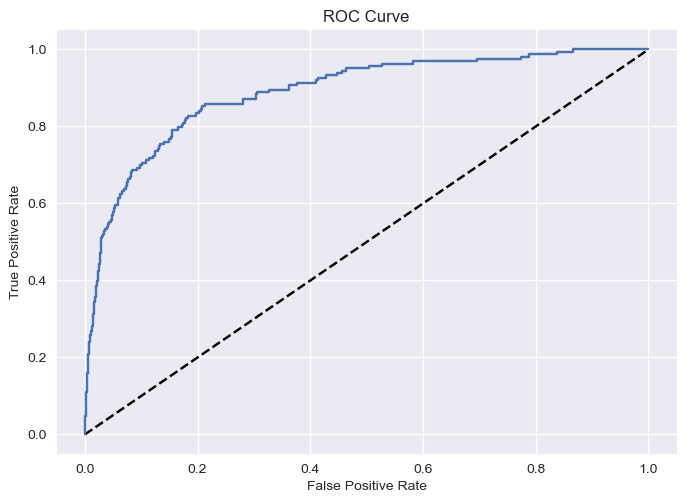

ROC AUC Score: 0.8893

XXXXXXXXXXXXXX CROSS VALIDATION XXXXXXXXXXXXXXXXXX

CV Accuracy Scores:
[0.97825496 0.97961403 0.98015765 0.97961403 0.97960848]

CV ROC AUC:
[0.91155152 0.8827107  0.89441092 0.89359748 0.85485532]

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX


In [117]:
#code block 117
vartrain = X_train_sc
vartest = X_test_sc
model = LogisticRegression(random_state=21)

modeltraintest(vartrain, vartest, y_train, y_test, model)

In [118]:
#code block 118
def shorttraintest(vartrain, vartest, y_train, y_test, model):

    #Fit the model
    model.fit(vartrain, y_train)

    #Predict with the model
    model_pred = model.predict(vartest)
    model_prob = model.predict_proba(vartest)


    print('Confusion Matrix:')
    print(confusion_matrix(y_test, model_pred))
    print("")

    #Assess with the model
    score = model.score(vartest, y_test)
    score_format = 'Accuracy Score: {0:.4f}'.format(score)
    print(score_format)

    recall = recall_score(y_test, model_pred)
    recall_format = 'Recall Score: {0:.4f}'.format(recall)
    print(recall_format)
    
    precision = precision_score(y_test, model_pred)
    precision_format = 'Precision Score: {0:.4f}'.format(precision)
    print(precision_format)
    
    # calculate roc curve
    y_pred_prob = model.predict_proba(vartest)[:,1]
    fpr, tpr, thresholds = roc_curve(y_test, y_pred_prob)
    roc_auc = roc_auc_score(y_test, y_pred_prob)
    roc_auc_format = 'ROC AUC Score: {0:.4f}'.format(roc_auc)
    print(roc_auc_format)
    print('')

In [119]:
#code block 119
vartrain = X_train_sc
vartest = X_test_sc
model = LogisticRegression(random_state=21)

shorttraintest(vartrain, vartest, y_train, y_test, model)

Confusion Matrix:
[[7714    7]
 [ 158    5]]

Accuracy Score: 0.9791
Recall Score: 0.0307
Precision Score: 0.4167
ROC AUC Score: 0.8893



In [120]:
#Code Block 120
from sklearn.model_selection import RandomizedSearchCV

grid={"C":[0.001, 0.01, 0.1, 1, 5, 10], "penalty":["l1","l2"], 
     "class_weight": [None, 'balanced', {0:1, 1:1.5}, {0:1, 1:2}, {0:1, 1:3}, {0:1, 1:5}], "solver":['lbfgs', 'liblinear']}
logreg=LogisticRegression(random_state=21)
logreg_cv=RandomizedSearchCV(logreg,grid,cv=10)
logreg_cv.fit(vartrain,y_train)

print("tuned hyperparameters :(best parameters) ",logreg_cv.best_params_)
print("accuracy :",logreg_cv.best_score_)

tuned hyperparameters :(best parameters)  {'solver': 'lbfgs', 'penalty': 'l2', 'class_weight': None, 'C': 0.001}
accuracy : 0.9800478757358679


XXXXXXXXXXXXXXXX ACCURACY SCORE XXXXXXXXXXXXXXXXXX
0.979072

XXXXXXXXXXXXXXXX CONFUSION MATRIX XXXXXXXXXXXXXXXX
[[7714    7]
 [ 158    5]]

XXXXXXXXXXXXXX CLASSIFICATION REPORT XXXXXXXXXXXXXX
              precision    recall  f1-score   support

           0       0.98      1.00      0.99      7721
           1       0.42      0.03      0.06       163

    accuracy                           0.98      7884
   macro avg       0.70      0.51      0.52      7884
weighted avg       0.97      0.98      0.97      7884


XXXXXXXXXXXXXX ROC AUC SCORE AND CHART XXXXXXXXXXXXXXXXXX



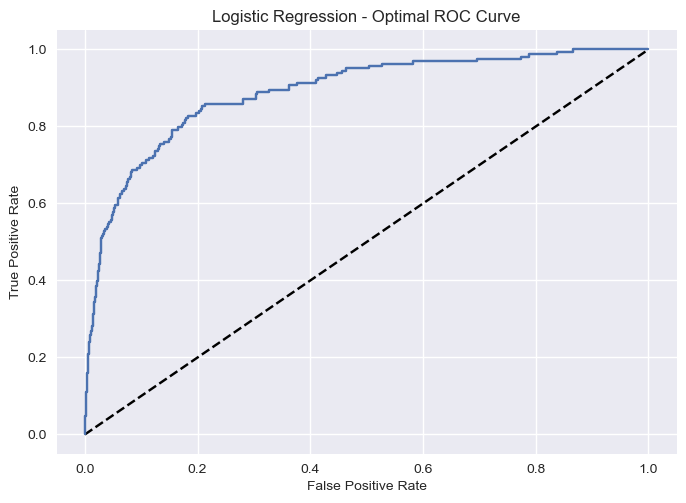

ROC AUC Score: 0.8893

XXXXXXXXXXXXXX CROSS VALIDATION XXXXXXXXXXXXXXXXXX

CV Accuracy Scores:
[0.97825496 0.97961403 0.98015765 0.97961403 0.97960848]

CV ROC AUC:
[0.91155152 0.8827107  0.89441092 0.89359748 0.85485532]

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX


In [121]:
#code block 121
vartrain = X_train_sc
vartest = X_test_sc

model.fit(vartrain, y_train)

#Predict with the model
optmodel_pred = model.predict(vartest)
optmodel_prob = model.predict_proba(vartest)

#Assess with the model
score = model.score(vartest, y_test)

print('XXXXXXXXXXXXXXXX ACCURACY SCORE XXXXXXXXXXXXXXXXXX')
print(round(score, 6))
print("")


print('XXXXXXXXXXXXXXXX CONFUSION MATRIX XXXXXXXXXXXXXXXX')
cm_opt = confusion_matrix(y_test, optmodel_pred)
print(cm_opt)
print("")


print('XXXXXXXXXXXXXX CLASSIFICATION REPORT XXXXXXXXXXXXXX')
print(classification_report(y_test, optmodel_pred))
print('')


print('XXXXXXXXXXXXXX ROC AUC SCORE AND CHART XXXXXXXXXXXXXXXXXX')
print('')
y_pred_prob = model.predict_proba(vartest)[:,1]

fpr_opt, tpr_opt, thresholds = roc_curve(y_test, y_pred_prob)

plt.plot([0, 1], [0, 1],'k--')
plt.plot(fpr_opt, tpr_opt, label='Logistic Regression')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Logistic Regression - Optimal ROC Curve')
plt.show();

# calculate roc curve
y_pred_prob = model.predict_proba(vartest)[:,1]

roc_auc = roc_auc_score(y_test, y_pred_prob)
roc_auc_format = 'ROC AUC Score: {0:.4f}'.format(roc_auc)
print(roc_auc_format)
print('')


print('XXXXXXXXXXXXXX CROSS VALIDATION XXXXXXXXXXXXXXXXXX')
print('')
cv_scores = cross_val_score(model, vartrain, y_train, cv=5,
scoring='accuracy')
print('CV Accuracy Scores:')
print(cv_scores)
print('')
cv_rocauc = cross_val_score(model, vartrain, y_train, cv=5,
scoring='roc_auc')
print('CV ROC AUC:')
print(cv_rocauc)

print('')
print('XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX')

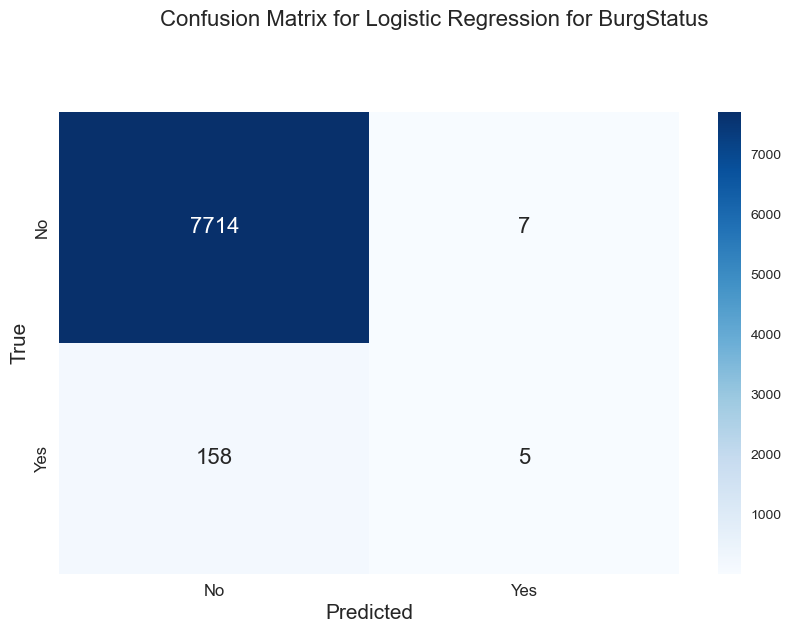

In [122]:
#code block 122
fig, axes = plt.subplots(nrows=1, ncols=1, sharex=True, figsize=(10, 6))
fig.suptitle('Confusion Matrix for Logistic Regression for BurgStatus', 
             fontsize=16, y=1.05)
ax = plt.subplot()
sns.heatmap(cm_opt, annot=True, cmap="Blues", annot_kws={"size": 16}, ax=ax, fmt="g")
ax.set_xlabel('Predicted', fontsize=15)
ax.set_ylabel('True', fontsize=15)
ax.xaxis.set_ticklabels(['No', 'Yes'], fontsize=12)
ax.yaxis.set_ticklabels(['No', 'Yes'], fontsize=12, va='center')
plt.show()

In [123]:
#code block 123
cw = [None, {0:1, 1:1}, 'balanced', {0:1, 1:1.5}, {0:1, 1:2}, {0:1, 1:2.5}, {0:1, 1:3}, {0:1, 1:4}, {0:1, 1:4.5},{0:1, 1:5}, {0:1, 1:5.5},{0:1, 1:10}, {0:1, 1:100}]

vartrain = X_train_sc
vartest = X_test_sc

for w in cw:
    print('----------------------')
    vartitle = "Model with Class Weight: " + str(w) 
    varcw = w
    model = LogisticRegression(random_state=21, C=1, penalty = 'l2', solver = 'liblinear', class_weight=varcw)
    print(vartitle)
    print('')
    shorttraintest(vartrain, vartest, y_train, y_test, model)
          
print('----------------------')



----------------------
Model with Class Weight: None

Confusion Matrix:
[[7714    7]
 [ 158    5]]

Accuracy Score: 0.9791
Recall Score: 0.0307
Precision Score: 0.4167
ROC AUC Score: 0.8899

----------------------
Model with Class Weight: {0: 1, 1: 1}

Confusion Matrix:
[[7714    7]
 [ 158    5]]

Accuracy Score: 0.9791
Recall Score: 0.0307
Precision Score: 0.4167
ROC AUC Score: 0.8899

----------------------
Model with Class Weight: balanced

Confusion Matrix:
[[6259 1462]
 [  32  131]]

Accuracy Score: 0.8105
Recall Score: 0.8037
Precision Score: 0.0822
ROC AUC Score: 0.8890

----------------------
Model with Class Weight: {0: 1, 1: 1.5}

Confusion Matrix:
[[7709   12]
 [ 153   10]]

Accuracy Score: 0.9791
Recall Score: 0.0613
Precision Score: 0.4545
ROC AUC Score: 0.8900

----------------------
Model with Class Weight: {0: 1, 1: 2}

Confusion Matrix:
[[7696   25]
 [ 143   20]]

Accuracy Score: 0.9787
Recall Score: 0.1227
Precision Score: 0.4444
ROC AUC Score: 0.8901

---------------

In [124]:
#code block 124
#Set the X training and test datasets
vartrain = X_train_sc
vartest = X_test_sc

#Set the model properties
model = LogisticRegression(random_state=21, C=1, class_weight = {0:1,1:100}, penalty = 'l2', solver = 'liblinear')


shorttraintest(vartrain, vartest, y_train, y_test, model)

Confusion Matrix:
[[5492 2229]
 [  21  142]]

Accuracy Score: 0.7146
Recall Score: 0.8712
Precision Score: 0.0599
ROC AUC Score: 0.8867



<div style="background-color:#3b528b;  color:white; padding:20px">
<h3> Decision Tree </h3>
</div>

In [125]:
#code block 125
from sklearn.tree import DecisionTreeClassifier # to build a classification tree
from sklearn.model_selection import train_test_split # to split data into training and testing sets
from sklearn.model_selection import cross_val_score # for cross validation
from sklearn.metrics import confusion_matrix, classification_report # to create a confusion matrix and classification report
from sklearn.metrics import ConfusionMatrixDisplay # to draw a confusion matrix
from sklearn.tree import plot_tree # to draw a classification tree
from sklearn.metrics import precision_score, recall_score
from sklearn.metrics import roc_curve, roc_auc_score

In [126]:
#code block 126
model=DecisionTreeClassifier(random_state=21)

In [127]:
#code block 127
model.fit(X_train,y_train)

DecisionTreeClassifier(random_state=21)

In [128]:
#code block 128
model_pred=model.predict(X_test)
print(model_pred)

[0 0 0 ... 0 0 0]


In [129]:
#code block 129
X_names=X_train.columns.values

In [130]:
#code block 130
model = DecisionTreeClassifier(max_leaf_nodes=10, random_state = 21)
model.fit(X_test, y_test)
model_pred = model.predict(X_test)
model

DecisionTreeClassifier(max_leaf_nodes=10, random_state=21)

In [131]:
#code block 131
print(confusion_matrix(y_test, model_pred))

print(classification_report(y_test, model_pred))

[[7684   37]
 [  98   65]]
              precision    recall  f1-score   support

           0       0.99      1.00      0.99      7721
           1       0.64      0.40      0.49       163

    accuracy                           0.98      7884
   macro avg       0.81      0.70      0.74      7884
weighted avg       0.98      0.98      0.98      7884



iteration 1 done
iteration 2 done
iteration 3 done
iteration 4 done
iteration 5 done
iteration 6 done
iteration 7 done
iteration 8 done
iteration 9 done
iteration 10 done
iteration 11 done
iteration 12 done
iteration 13 done
iteration 14 done
iteration 15 done
iteration 16 done
iteration 17 done
iteration 18 done
iteration 19 done


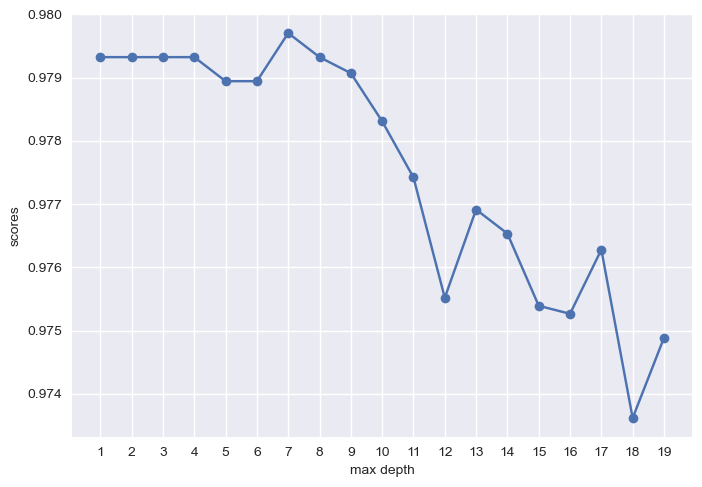

In [132]:
#code block 132
est = range(1,20)
scores = []
var_est = 'max depth'

for d in est:
    classifier=DecisionTreeClassifier(max_depth = d, random_state = 21)
    classifier=classifier.fit(X_train,y_train)
    scores.append(classifier.score(X_test, y_test))
    print("iteration {} done".format(d))


plt.plot(est, scores, '-o')
plt.xlabel(var_est)
plt.ylabel('scores')
plt.xticks(est)
plt.show()

In [133]:
#code block 133
vartrain = X_train
vartest = X_test
model = DecisionTreeClassifier(max_depth=7, random_state = 21)

shorttraintest(vartrain, vartest, y_train, y_test, model)

Confusion Matrix:
[[7697   24]
 [ 136   27]]

Accuracy Score: 0.9797
Recall Score: 0.1656
Precision Score: 0.5294
ROC AUC Score: 0.9238



iteration 30 done
iteration 31 done
iteration 32 done
iteration 33 done
iteration 34 done
iteration 35 done
iteration 36 done
iteration 37 done
iteration 38 done
iteration 39 done
iteration 40 done
iteration 41 done
iteration 42 done
iteration 43 done
iteration 44 done
iteration 45 done
iteration 46 done
iteration 47 done
iteration 48 done
iteration 49 done


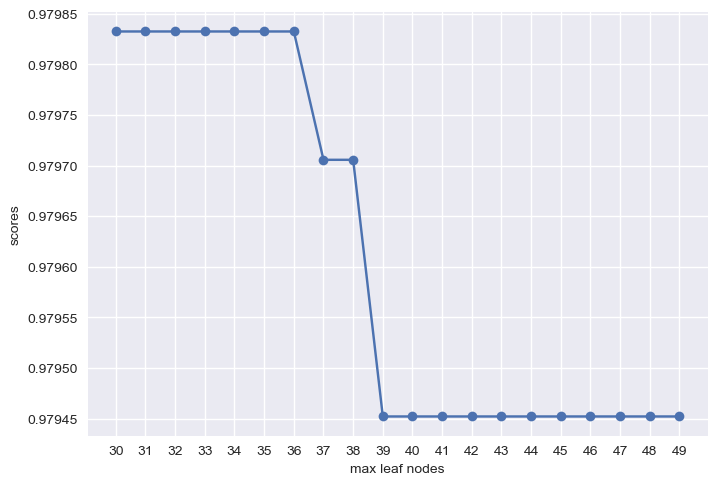

In [134]:
#code block 134
figsize=(20, 5)
est = range(30,50)
scores = []
var_est = 'max leaf nodes'

for d in est:
    classifier=DecisionTreeClassifier(max_depth = 7, max_leaf_nodes = d, random_state = 21)
    classifier=classifier.fit(X_train,y_train)
    scores.append(classifier.score(X_test, y_test))
    print("iteration {} done".format(d))


plt.plot(est, scores, '-o')
plt.xlabel(var_est)
plt.ylabel('scores')
plt.xticks(est)
plt.show()

In [135]:
#code block 135
cw = [None, 'balanced', {0:1, 1:1.5}, {0:1, 1:2}, {0:1, 1:3}, {0:1, 1:5}, {0:1, 1:10}, {0:1, 1:100}]

vartrain = X_train
vartest = X_test

for w in cw:
    print('----------------------')
    vartitle = "Model with Class Weight: " + str(w) 
    varcw = w
    model = DecisionTreeClassifier(max_depth = 7, max_leaf_nodes = 30, class_weight=varcw, random_state = 21)
    print(vartitle)
    print('')
    shorttraintest(vartrain, vartest, y_train, y_test, model)


          
print('----------------------')


----------------------
Model with Class Weight: None

Confusion Matrix:
[[7700   21]
 [ 138   25]]

Accuracy Score: 0.9798
Recall Score: 0.1534
Precision Score: 0.5435
ROC AUC Score: 0.9097

----------------------
Model with Class Weight: balanced

Confusion Matrix:
[[6803  918]
 [  22  141]]

Accuracy Score: 0.8808
Recall Score: 0.8650
Precision Score: 0.1331
ROC AUC Score: 0.8885

----------------------
Model with Class Weight: {0: 1, 1: 1.5}

Confusion Matrix:
[[7673   48]
 [ 126   37]]

Accuracy Score: 0.9779
Recall Score: 0.2270
Precision Score: 0.4353
ROC AUC Score: 0.8781

----------------------
Model with Class Weight: {0: 1, 1: 2}

Confusion Matrix:
[[7580  141]
 [  72   91]]

Accuracy Score: 0.9730
Recall Score: 0.5583
Precision Score: 0.3922
ROC AUC Score: 0.9150

----------------------
Model with Class Weight: {0: 1, 1: 3}

Confusion Matrix:
[[7585  136]
 [  74   89]]

Accuracy Score: 0.9734
Recall Score: 0.5460
Precision Score: 0.3956
ROC AUC Score: 0.9159

---------------

In [136]:
#code block 136
from sklearn.model_selection import RandomizedSearchCV

vartrain = X_train
vartest = X_test

grid={"criterion": ['gini', 'entropy'], "max_depth" : [5, 6, 7, 8, 9],
      "max_leaf_nodes" : [28, 30, 32, 34, 36],
      "class_weight": [None, 'balanced', {0:1, 1:1.5}, {0:1, 1:2}, {0:1, 1:3}]}
model_random = DecisionTreeClassifier(random_state = 21)
model_cv=RandomizedSearchCV(model_random,grid,cv=5)
model_cv.fit(vartrain,y_train)

print("tuned hyperparameters :(best parameters) ",model_cv.best_params_)
print("accuracy :",model_cv.best_score_)

tuned hyperparameters :(best parameters)  {'max_leaf_nodes': 32, 'max_depth': 8, 'criterion': 'gini', 'class_weight': None}
accuracy : 0.9798846117633981


In [137]:
#code block 137
cw = [None, 'balanced', {0:1, 1:2}, {0:1, 1:3}, {0:1, 1:5}, {0:1, 1:10}, {0:1, 1:50}, {0:1, 1:100}]

vartrain = X_train
vartest = X_test

for w in cw:
    print('----------------------')
    vartitle = "Model with Class Weight: " + str(w) 
    varcw = w
    #Set the model properties
    model = DecisionTreeClassifier(max_depth = 5, max_leaf_nodes = 34, 
                               class_weight=varcw, criterion = 'entropy', random_state = 21)#Assess with the model
    print(vartitle)
    print('')
    shorttraintest(vartrain, vartest, y_train, y_test, model)


          
print('----------------------')

----------------------
Model with Class Weight: None

Confusion Matrix:
[[7721    0]
 [ 163    0]]

Accuracy Score: 0.9793
Recall Score: 0.0000
Precision Score: 0.0000
ROC AUC Score: 0.9309

----------------------
Model with Class Weight: balanced

Confusion Matrix:
[[6177 1544]
 [  14  149]]

Accuracy Score: 0.8024
Recall Score: 0.9141
Precision Score: 0.0880
ROC AUC Score: 0.9256

----------------------
Model with Class Weight: {0: 1, 1: 2}

Confusion Matrix:
[[7561  160]
 [  59  104]]

Accuracy Score: 0.9722
Recall Score: 0.6380
Precision Score: 0.3939
ROC AUC Score: 0.9309

----------------------
Model with Class Weight: {0: 1, 1: 3}

Confusion Matrix:
[[7533  188]
 [  50  113]]

Accuracy Score: 0.9698
Recall Score: 0.6933
Precision Score: 0.3754
ROC AUC Score: 0.9309

----------------------
Model with Class Weight: {0: 1, 1: 5}

Confusion Matrix:
[[7505  216]
 [  48  115]]

Accuracy Score: 0.9665
Recall Score: 0.7055
Precision Score: 0.3474
ROC AUC Score: 0.9309

-----------------

In [138]:
#code block 138
vartrain = X_train
vartest = X_test

#Set the model properties
model_dt = DecisionTreeClassifier(max_depth = 5, max_leaf_nodes = 34, 
                               class_weight={0:1,1:100}, criterion = 'entropy', random_state = 21)

#Assess with the model
model_dt.fit(vartrain, y_train)

#Predict with the model
model_pred = model_dt.predict(vartest)
model_prob = model_dt.predict_proba(vartest)


print('Confusion Matrix:')
cm_dt = confusion_matrix(y_test, model_pred)
print(cm_dt)
print("")

Confusion Matrix:
[[6287 1434]
 [  14  149]]



Accuracy Score: 0.8163
Recall Score: 0.9141
Precision Score: 0.0941


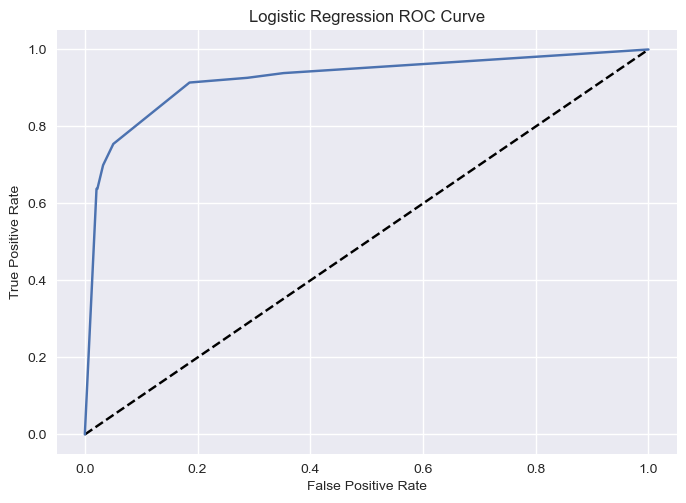

In [139]:
#code block 139
score = model_dt.score(vartest, y_test)
score_format = 'Accuracy Score: {0:.4f}'.format(score)
print(score_format)

recall = recall_score(y_test, model_pred)
recall_format = 'Recall Score: {0:.4f}'.format(recall)
print(recall_format)

precision = precision_score(y_test, model_pred)
precision_format = 'Precision Score: {0:.4f}'.format(precision)
print(precision_format)

y_pred_prob = model_dt.predict_proba(vartest)[:,1]

dt_fpr, dt_tpr, thresholds = roc_curve(y_test, y_pred_prob)

plt.plot([0, 1], [0, 1],'k--')
plt.plot(dt_fpr, dt_tpr, label='Logistic Regression')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Logistic Regression ROC Curve')
plt.show();


In [140]:
#code block 140
cw = [None, 'balanced', {0:1, 1:2}, {0:1, 1:3}, {0:1, 1:5}, {0:1, 1:10}, {0:1, 1:50}, {0:1, 1:100}]

vartrain = X_train
vartest = X_test

for w in cw:
    print('----------------------')
    vartitle = "Model with Class Weight: " + str(w) 
    varcw = w
    #Set the model properties
    model = DecisionTreeClassifier(max_depth = 4, max_leaf_nodes = 30, 
                               class_weight=varcw, criterion = 'gini', random_state = 21)#Assess with the model
    print(vartitle)
    print('')
    shorttraintest(vartrain, vartest, y_train, y_test, model)


          
print('----------------------')

----------------------
Model with Class Weight: None

Confusion Matrix:
[[7721    0]
 [ 163    0]]

Accuracy Score: 0.9793
Recall Score: 0.0000
Precision Score: 0.0000
ROC AUC Score: 0.9153

----------------------
Model with Class Weight: balanced

Confusion Matrix:
[[7128  593]
 [  27  136]]

Accuracy Score: 0.9214
Recall Score: 0.8344
Precision Score: 0.1866
ROC AUC Score: 0.9199

----------------------
Model with Class Weight: {0: 1, 1: 2}

Confusion Matrix:
[[7717    4]
 [ 161    2]]

Accuracy Score: 0.9791
Recall Score: 0.0123
Precision Score: 0.3333
ROC AUC Score: 0.9250

----------------------
Model with Class Weight: {0: 1, 1: 3}

Confusion Matrix:
[[7482  239]
 [  47  116]]

Accuracy Score: 0.9637
Recall Score: 0.7117
Precision Score: 0.3268
ROC AUC Score: 0.9250

----------------------
Model with Class Weight: {0: 1, 1: 5}

Confusion Matrix:
[[7482  239]
 [  47  116]]

Accuracy Score: 0.9637
Recall Score: 0.7117
Precision Score: 0.3268
ROC AUC Score: 0.9250

-----------------

Confusion Matrix:
[[6260 1461]
 [  16  147]]

Accuracy Score: 0.8127
Recall Score: 0.9018
Precision Score: 0.0914


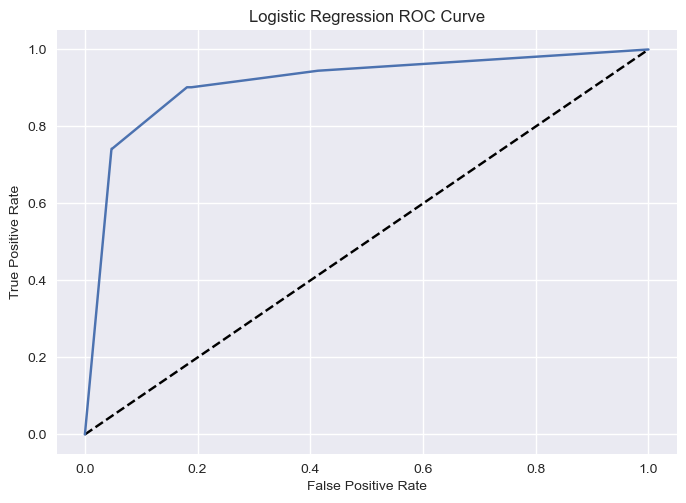

In [141]:
#code block 141
vartrain = X_train
vartest = X_test

#Set the model properties
model_dt_3 = DecisionTreeClassifier(max_depth = 5, max_leaf_nodes = 34, 
                               class_weight={0: 1, 1: 100}, criterion = 'gini', random_state = 21)

#Assess with the model
model_dt_3.fit(vartrain, y_train)

#Predict with the model
model_pred = model_dt_3.predict(vartest)
model_prob = model_dt_3.predict_proba(vartest)


print('Confusion Matrix:')
cm_dt_3 = confusion_matrix(y_test, model_pred)
print(cm_dt_3)
print("")

#Assess with the model
score = model_dt_3.score(vartest, y_test)
score_format = 'Accuracy Score: {0:.4f}'.format(score)
print(score_format)

recall = recall_score(y_test, model_pred)
recall_format = 'Recall Score: {0:.4f}'.format(recall)
print(recall_format)

precision = precision_score(y_test, model_pred)
precision_format = 'Precision Score: {0:.4f}'.format(precision)
print(precision_format)

y_pred_prob = model_dt_3.predict_proba(vartest)[:,1]

dt_3_fpr, dt_3_tpr, thresholds = roc_curve(y_test, y_pred_prob)

plt.plot([0, 1], [0, 1],'k--')
plt.plot(dt_3_fpr, dt_3_tpr, label='Logistic Regression')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Logistic Regression ROC Curve')
plt.show();

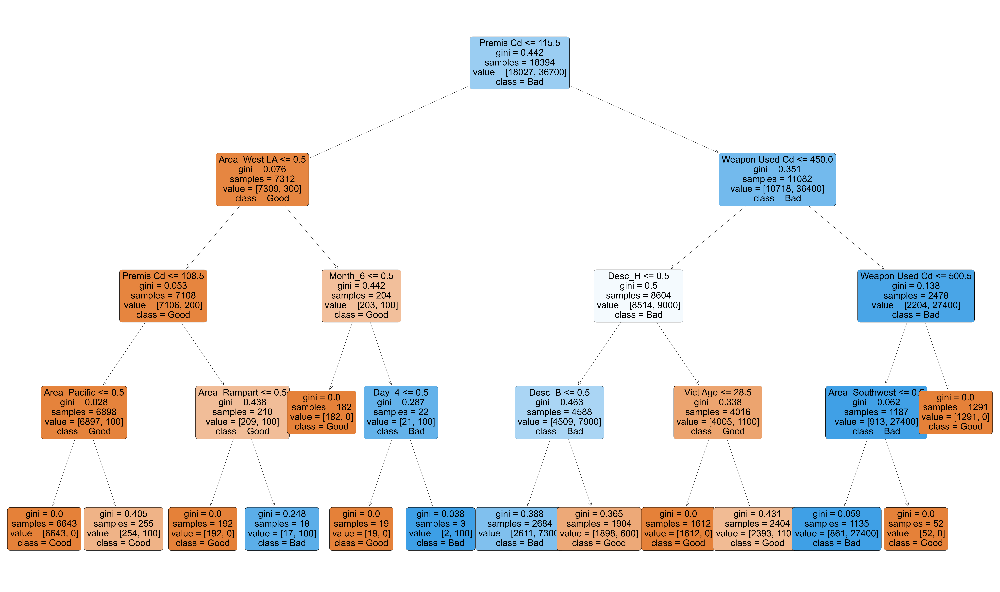

In [142]:
#code block 142
from sklearn import tree

plt.rcParams['text.color'] = 'black'
plt.figure(figsize=(27, 16), dpi=400)

plot_tree(model, 
          filled=True, 
          rounded=True,
          fontsize=14,
          proportion=False,
          class_names=["Good", "Bad"], 
          feature_names=X_names); 

[Text(0, 0.5, 'No'), Text(0, 1.5, 'Yes')]

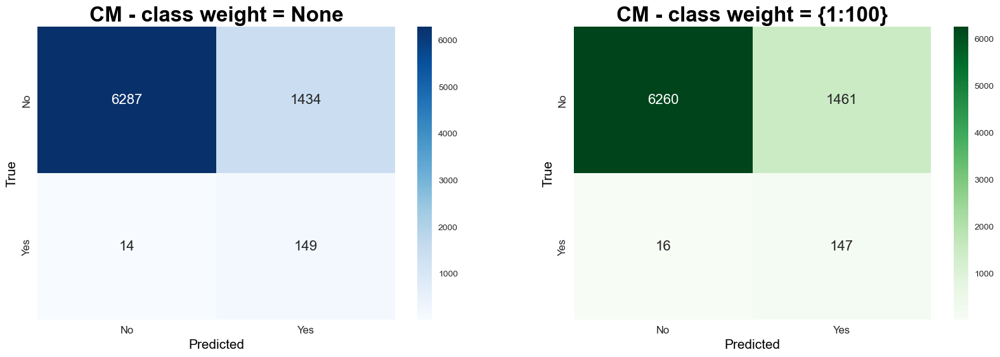

In [143]:
#code block 143
plt.figure(figsize=(20,6))
plt.subplot(121)

plt.title('CM - class weight = None',fontweight='bold', color = 'black', fontsize='24', horizontalalignment='center')
chart = sns.heatmap(cm_dt, annot=True, cmap="Blues", annot_kws={"size": 16}, fmt="g")
chart.set_xlabel('Predicted', fontsize=15)
chart.set_ylabel('True', fontsize=15)
chart.xaxis.set_ticklabels(['No', 'Yes'], fontsize=12)
chart.yaxis.set_ticklabels(['No', 'Yes'], fontsize=12, va='center')


plt.subplot(122)
plt.title('CM - class weight = {1:100}',fontweight='bold', color = 'black', fontsize='24', horizontalalignment='center')
chart = sns.heatmap(cm_dt_3, annot=True, cmap="Greens", annot_kws={"size": 16}, fmt="g")
chart.set_xlabel('Predicted', fontsize=15)
chart.set_ylabel('True', fontsize=15)
chart.xaxis.set_ticklabels(['No', 'Yes'], fontsize=12)
chart.yaxis.set_ticklabels(['No', 'Yes'], fontsize=12, va='center')

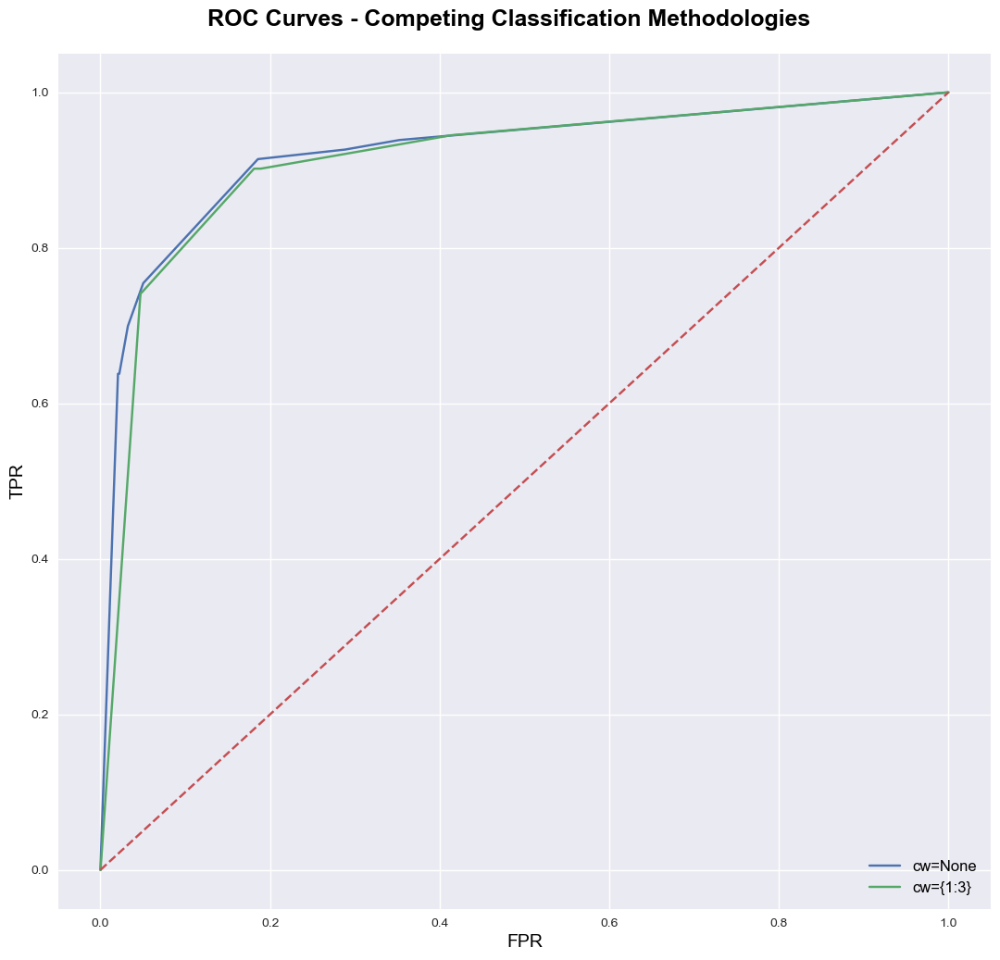

In [144]:
#code block 144
plt.figure(figsize = (13,12))
plt.suptitle('ROC Curves - Competing Classification Methodologies', fontweight='bold', fontsize=18, y=.92)
plt.plot(dt_fpr, dt_tpr, label='cw=None')
plt.plot(dt_3_fpr, dt_3_tpr, label='cw={1:3}')
plt.plot([0,1], [0,1], linestyle='--')
plt.xlim([-0.05, 1.05])
plt.ylim([-0.05, 1.05])
plt.xlabel('FPR', fontsize=14)
plt.ylabel('TPR', fontsize=14)
plt.legend(loc="lower right", frameon=False, fontsize=12)
plt.show()

In [145]:
#code block 145
X_names = pd.DataFrame(list(X.columns))

In [146]:
#code block 146
df_fi = pd.DataFrame(model_dt.feature_importances_)
df_fi

,0
0,0.034299
1,0.229107
2,0.580792
3,0.010153
4,0.000000
...,...
66,0.000000
67,0.000000
68,0.000000
69,0.000000


In [147]:
#code block 147
df_fi_3 = pd.DataFrame(model_dt_3.feature_importances_)

In [148]:
#code block 148
df_fi_3 = pd.DataFrame(model_dt_3.feature_importances_)
df_feat_imp = pd.concat([X_names, df_fi, df_fi_3], axis = 1)
df_feat_imp.columns = ['Features', 'dt_importance', 'dt_3_importance']
df_feat_imp

,Features,dt_importance,dt_3_importance
0,Vict Age,0.034299,0.012796
1,Premis Cd,0.229107,0.428763
2,Weapon Used Cd,0.580792,0.379116
3,LAT,0.010153,0.007048
4,LON,0.000000,0.000000
...,...,...,...
66,Day_6,0.000000,0.000000
67,Time_Afternoon,0.000000,0.000000
68,Time_Evening,0.000000,0.000000
69,Time_Morning,0.000000,0.000000


In [149]:
#code block 149
df_feat_imp[(df_feat_imp['dt_3_importance']!=0) | (df_feat_imp['dt_importance']!=0)].sort_values('dt_3_importance', ascending = False)

,Features,dt_importance,dt_3_importance
1,Premis Cd,0.229107,0.428763
2,Weapon Used Cd,0.580792,0.379116
14,Desc_H,0.069034,0.075049
9,Desc_B,0.054122,0.057501
0,Vict Age,0.034299,0.012796
57,Month_10,0.000000,0.012133
3,LAT,0.010153,0.007048
40,Area_Rampart,0.000000,0.006212
53,Month_6,0.000000,0.005807
42,Area_Southwest,0.000000,0.005707


<div style="background-color:#3b528b;  color:white; padding:20px">
<h3> RandomForest </h3>
</div>

In [150]:
#code block 150
vartrain = X_train
vartest = X_test
model = RandomForestClassifier(max_depth=12, random_state=21)

shorttraintest(vartrain, vartest, y_train, y_test, model)

Confusion Matrix:
[[7721    0]
 [ 163    0]]

Accuracy Score: 0.9793
Recall Score: 0.0000
Precision Score: 0.0000
ROC AUC Score: 0.9487



iteration 6 done. Accuracy = 0.9793252156265855
iteration 8 done. Accuracy = 0.9793252156265855
iteration 10 done. Accuracy = 0.9793252156265855
iteration 12 done. Accuracy = 0.9793252156265855
iteration 14 done. Accuracy = 0.9795788939624556
iteration 16 done. Accuracy = 0.9800862506341959
iteration 17 done. Accuracy = 0.9803399289700659
iteration 18 done. Accuracy = 0.980593607305936
iteration 19 done. Accuracy = 0.9800862506341959
iteration 20 done. Accuracy = 0.9809741248097412
iteration 21 done. Accuracy = 0.9811009639776763
iteration 22 done. Accuracy = 0.9809741248097412
iteration 23 done. Accuracy = 0.9808472856418062
iteration 30 done. Accuracy = 0.9803399289700659


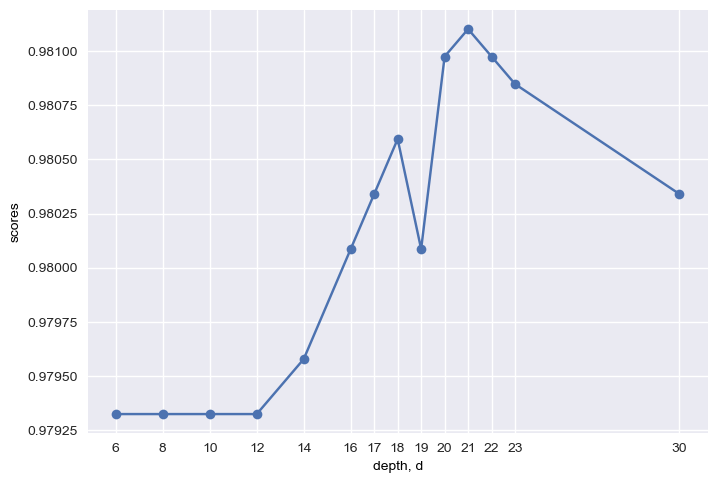

In [151]:
#code block 151
depth = [6, 8, 10, 12, 14, 16, 17, 18, 19, 20, 21, 22, 23, 30]

#Creates an empty list
scores = []

for d in depth:
    classifier=RandomForestClassifier(max_depth = d, random_state = 21)
    classifier=classifier.fit(X_train,y_train)
    score = classifier.score(X_test, y_test)
    scores.append(classifier.score(X_test, y_test))
    print("iteration {} done. Accuracy = ".format(d) + str(score))


plt.plot(depth, scores, '-o')
plt.xlabel('depth, d')
plt.ylabel('scores')
plt.xticks(depth)
plt.show()

iteration 1 done. Accuracy = 0.9793252156265855
iteration 2 done. Accuracy = 0.9791983764586504
iteration 3 done. Accuracy = 0.9793252156265855
iteration 4 done. Accuracy = 0.9791983764586504
iteration 5 done. Accuracy = 0.9795788939624556
iteration 6 done. Accuracy = 0.9800862506341959
iteration 7 done. Accuracy = 0.9795788939624556
iteration 8 done. Accuracy = 0.9811009639776763
iteration 9 done. Accuracy = 0.9809741248097412
iteration 10 done. Accuracy = 0.9813546423135464
iteration 11 done. Accuracy = 0.9821156773211568
iteration 12 done. Accuracy = 0.9819888381532217
iteration 13 done. Accuracy = 0.9818619989852867


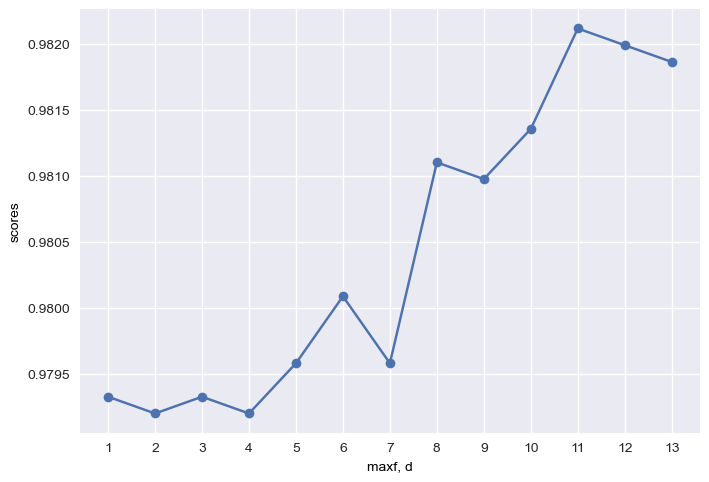

In [152]:
#code block 152
figsize=(20, 5)
maxf = range(1,14)
scores = []

for d in maxf:
    classifier=RandomForestClassifier(max_depth = 21, max_features = d, random_state=21)
    classifier=classifier.fit(X_train,y_train)
    score = classifier.score(X_test, y_test)
    scores.append(classifier.score(X_test, y_test))
    print("iteration {} done. Accuracy = ".format(d) + str(score))


plt.plot(maxf, scores, '-o')
plt.xlabel('maxf, d')
plt.ylabel('scores')
plt.xticks(maxf)
plt.show()

iteration 1 done. Accuracy = 0.9701927955352613
iteration 20 done. Accuracy = 0.9816083206494165
iteration 50 done. Accuracy = 0.9821156773211568
iteration 100 done. Accuracy = 0.9821156773211568
iteration 150 done. Accuracy = 0.9823693556570269
iteration 500 done. Accuracy = 0.9817351598173516


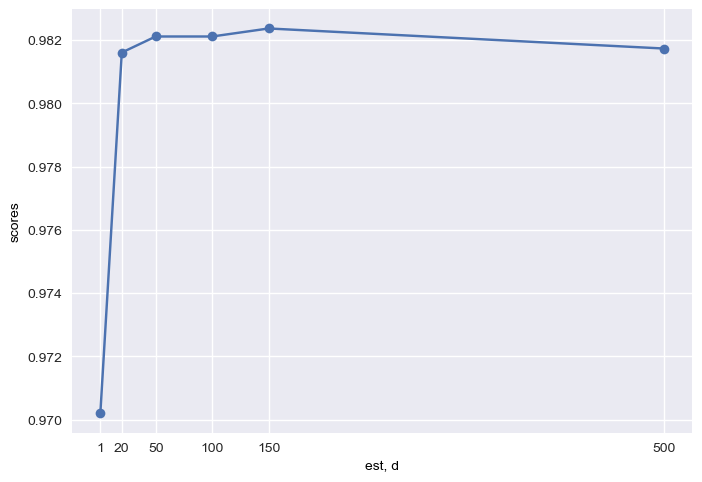

In [153]:
#code block 153
figsize=(20, 5)
est = [1, 20, 50, 100, 150, 500]
scores = []

for d in est:
    classifier=RandomForestClassifier(max_depth = 21, max_features = 11, n_estimators = d, random_state=21)
    classifier=classifier.fit(X_train,y_train)
    score = classifier.score(X_test, y_test)
    scores.append(classifier.score(X_test, y_test))
    print("iteration {} done. Accuracy = ".format(d) + str(score))


plt.plot(est, scores, '-o')
plt.xlabel('est, d')
plt.ylabel('scores')
plt.xticks(est)
plt.show() 

In [154]:
#code block 154
cw = [None, 'balanced', {0:1, 1:2}, {0:1, 1:3}, {0:1, 1:5}, {0:1, 1:10}, 
      {0:1, 1:20}, {0:1, 1:25}, {0:1, 1:30}, {0:1, 1:50}, {0:1, 1:100}]

vartrain = X_train
vartest = X_test

for w in cw:
    print('----------------------')
    vartitle = "Model with Class Weight: " + str(w) 
    varcw = w
    model = RandomForestClassifier(max_depth = 21, max_features = 11, n_estimators = 20, class_weight=varcw)
    print(vartitle)
    print('')
    shorttraintest(vartrain, vartest, y_train, y_test, model)


          
print('----------------------')



----------------------
Model with Class Weight: None

Confusion Matrix:
[[7714    7]
 [ 141   22]]

Accuracy Score: 0.9812
Recall Score: 0.1350
Precision Score: 0.7586
ROC AUC Score: 0.9193

----------------------
Model with Class Weight: balanced

Confusion Matrix:
[[7690   31]
 [ 118   45]]

Accuracy Score: 0.9811
Recall Score: 0.2761
Precision Score: 0.5921
ROC AUC Score: 0.9182

----------------------
Model with Class Weight: {0: 1, 1: 2}

Confusion Matrix:
[[7714    7]
 [ 138   25]]

Accuracy Score: 0.9816
Recall Score: 0.1534
Precision Score: 0.7812
ROC AUC Score: 0.9189

----------------------
Model with Class Weight: {0: 1, 1: 3}

Confusion Matrix:
[[7713    8]
 [ 147   16]]

Accuracy Score: 0.9803
Recall Score: 0.0982
Precision Score: 0.6667
ROC AUC Score: 0.9137

----------------------
Model with Class Weight: {0: 1, 1: 5}

Confusion Matrix:
[[7710   11]
 [ 145   18]]

Accuracy Score: 0.9802
Recall Score: 0.1104
Precision Score: 0.6207
ROC AUC Score: 0.9121

-----------------

In [155]:
#code block 155
vartrain = X_train
vartest = X_test


grid={"criterion": ['gini', 'entropy'], "max_depth" : [10, 13, 15, 17, 19, 21, 23],
      "n_estimators" : [20], "max_features" : [10, 11, 13, 14, 17],
      "class_weight": [None]}
model_random = RandomForestClassifier(random_state=21)
model_cv=RandomizedSearchCV(model_random,grid,cv=5)
model_cv.fit(vartrain,y_train)

print("tuned hyperparameters :(best parameters) ",model_cv.best_params_)
print("accuracy :", model_cv.best_score_)

tuned hyperparameters :(best parameters)  {'n_estimators': 20, 'max_features': 17, 'max_depth': 17, 'criterion': 'gini', 'class_weight': None}
accuracy : 0.9826029781776586


In [156]:
#code block 156
cw = [None, 'balanced', {0:1, 1:2}, {0:1, 1:3}, {0:1, 1:5}, {0:1, 1:7.5}, {0:1, 1:10}, {0:1, 1:25},  {0:1, 1:100}]

vartrain = X_train
vartest = X_test

for w in cw:
    print('----------------------')
    vartitle = "Model with Class Weight: " + str(w) 
    varcw = w
    #Set the model properties
    model = RandomForestClassifier(max_depth = 13, max_features = 14, n_estimators = 20, 
                                   class_weight=varcw, criterion = 'entropy', random_state=21)
    print(vartitle)
    print('')
    shorttraintest(vartrain, vartest, y_train, y_test, model)


          
print('----------------------')




----------------------
Model with Class Weight: None

Confusion Matrix:
[[7713    8]
 [ 151   12]]

Accuracy Score: 0.9798
Recall Score: 0.0736
Precision Score: 0.6000
ROC AUC Score: 0.9424

----------------------
Model with Class Weight: balanced

Confusion Matrix:
[[7578  143]
 [  64   99]]

Accuracy Score: 0.9737
Recall Score: 0.6074
Precision Score: 0.4091
ROC AUC Score: 0.9363

----------------------
Model with Class Weight: {0: 1, 1: 2}

Confusion Matrix:
[[7705   16]
 [ 132   31]]

Accuracy Score: 0.9812
Recall Score: 0.1902
Precision Score: 0.6596
ROC AUC Score: 0.9421

----------------------
Model with Class Weight: {0: 1, 1: 3}

Confusion Matrix:
[[7699   22]
 [ 116   47]]

Accuracy Score: 0.9825
Recall Score: 0.2883
Precision Score: 0.6812
ROC AUC Score: 0.9508

----------------------
Model with Class Weight: {0: 1, 1: 5}

Confusion Matrix:
[[7686   35]
 [ 108   55]]

Accuracy Score: 0.9819
Recall Score: 0.3374
Precision Score: 0.6111
ROC AUC Score: 0.9424

-----------------

XXXXXXXXXXXXXXXX ACCURACY SCORE XXXXXXXXXXXXXXXXXX
0.963851

XXXXXXXXXXXXXXXX CONFUSION MATRIX XXXXXXXXXXXXXXXX
[[7490  231]
 [  54  109]]

XXXXXXXXXXXXXX CLASSIFICATION REPORT XXXXXXXXXXXXXX
              precision    recall  f1-score   support

           0       0.99      0.97      0.98      7721
           1       0.32      0.67      0.43       163

    accuracy                           0.96      7884
   macro avg       0.66      0.82      0.71      7884
weighted avg       0.98      0.96      0.97      7884


XXXXXXXXXXXXXX ROC AUC SCORE AND CHART XXXXXXXXXXXXXXXXXX



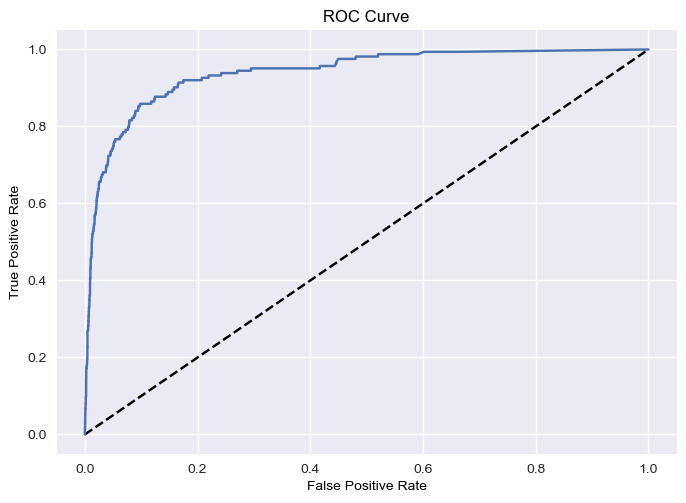

ROC AUC Score: 0.9399

XXXXXXXXXXXXXX CROSS VALIDATION XXXXXXXXXXXXXXXXXX

CV Accuracy Scores:
[0.97145964 0.97336233 0.97145964 0.96874151 0.96601414]

CV ROC AUC:
[0.93933817 0.91475015 0.95906961 0.95514863 0.92855053]

XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX


In [157]:
#code block 157
#Set the X training and test datasets
vartrain = X_train
vartest = X_test

#Set the model properties
model = RandomForestClassifier(max_depth = 13, max_features = 14, n_estimators = 20, class_weight={0:1,1:100}, criterion = 'entropy', random_state=21)

modeltraintest(vartrain, vartest, y_train, y_test, model)

In [158]:
#code block 158
df_fi = pd.DataFrame(model.feature_importances_)
df_fi

,0
0,0.089815
1,0.187504
2,0.237971
3,0.059437
4,0.054036
...,...
66,0.003942
67,0.004633
68,0.004925
69,0.004061


In [159]:
#code block 159
X_names = pd.DataFrame(list(X.columns))

In [160]:
#code block 160
df_feat_imp = pd.concat([df_fi, X_names], axis = 1)
df_feat_imp.columns = ['Importance', 'Features']
df_feat_imp[df_feat_imp['Importance']!=0].sort_values('Importance', ascending = False)

,Importance,Features
2,0.237971,Weapon Used Cd
1,0.187504,Premis Cd
0,0.089815,Vict Age
14,0.079250,Desc_H
3,0.059437,LAT
4,0.054036,LON
9,0.028775,Desc_B
7,0.022415,DayofWeek
25,0.021891,Desc_X
6,0.020385,Month


<div style="background-color:#3b528b;  color:white; padding:20px">
<h3> The Best Model </h3>
</div>
- create a summary table

In [161]:
#code block 161
from sklearn.tree import DecisionTreeClassifier # to build a classification tree
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier

from sklearn.model_selection import train_test_split # to split data into training and testing sets
from sklearn.model_selection import cross_val_score # for cross validation
from sklearn.metrics import confusion_matrix, classification_report # to create a confusion matrix and classification report
from sklearn.metrics import ConfusionMatrixDisplay # to draw a confusion matrix
from sklearn import tree
from sklearn.tree import plot_tree # to draw a classification tree
from sklearn.metrics import precision_score, recall_score, f1_score
from sklearn.metrics import roc_curve, roc_auc_score

In [162]:
#code block 162
model = [
         
#Logistic Regression - 2 models
         (X_train_sc, X_test_sc, y_train,'log_opt','Logistic',
        LogisticRegression(C=1, penalty = 'l2', class_weight= None,solver = 'liblinear', random_state=21)),
         (X_train_sc, X_test_sc, y_train,'log_dec', 'Logistic',
          LogisticRegression(C=0.001,class_weight={0:1,1:100},penalty = 'l2', solver = 'liblinear',random_state=21)),
        

#Decision Tree - 2 models
         (X_train, X_test, y_train,'dt_opt', 'DecisionTree',
          DecisionTreeClassifier(max_depth= 5,max_leaf_nodes=34,class_weight=None,criterion="entropy",random_state=21)),
         (X_train, X_test, y_train,'dt_dec', 'DecisionTree',
          DecisionTreeClassifier(max_depth= 5,max_leaf_nodes=34,class_weight={0:1,1:100},criterion="entropy",random_state=21)),
          

#Random Forest - 2 models
         (X_train, X_test, y_train,'rf_opt', 'RandomForest',
          RandomForestClassifier(max_depth=13, max_features=14, n_estimators=20,class_weight=None,criterion="entropy",random_state=21)),
         (X_train, X_test, y_train,'rf_dec', 'RandomForest',
         RandomForestClassifier(max_depth=13, max_features=14, n_estimators=20,class_weight={0:1,1:100}, criterion="entropy",random_state=21)),
]
          
cm_all = pd.DataFrame(columns=['Model', 'Type','pred_noburg', 'pred_burg', 'Score', 'Recall', 'Precision', 'F1'])

for tr, tst, yt, n, mod, m in model:
    m.fit(tr, yt) 
    model_pred = m.predict(tst)
    model_prob = m.predict_proba(tst)
    score = m.score(tst, y_test)
    score_format = '{0:.4f}'.format(score)
    
    recall = recall_score(y_test, model_pred)
    recall_format = '{0:.4f}'.format(recall)

    f1 = f1_score(y_test, model_pred)
    f1_format = '{0:.4f}'.format(f1)
    
    precision = precision_score(y_test, model_pred)
    precision_format = '{0:.4f}'.format(precision)

    y_pred_prob = m.predict_proba(tst)[:,1]
    fpr, tpr, thresholds = roc_curve(y_test, y_pred_prob)
    exec(f'fpr_{n} = fpr')
    exec(f'tpr_{n} = tpr')
    exec(f'thresholds_{n} = thresholds')
    exec(f'{n} = n')
    
    
    cm = pd.DataFrame(confusion_matrix(y_test, model_pred))
    cm=cm.rename(columns = {0:'pred_noburg', 1:'pred_burg'})
    
    exec(f'cm_{n} = cm')
    cm['Model'] = mod
    cm['Type'] = n
    cm['Score'] = score_format
    cm['Recall'] = recall_format
    cm['Precision'] = precision_format
    cm['F1'] = f1_format

    
    cm_all = pd.concat([cm_all, cm], axis=0)  
    print(n + " - Score: " + str(score_format) + " - Recall: " + str(recall_format) + " - Precision: " + str(precision_format) + " - F1: " + str(f1_format))    
    print('----------------------------------------------------------------')

cm_all = cm_all.reset_index()
cm_all['index'] = np.where(cm_all['index']==0, 'no_burglary', 'burglary')
cm_all = cm_all.rename(columns={'index':'actual'})

display(cm_all)
print('--------------------------------------------------------------------')


log_opt - Score: 0.9791 - Recall: 0.0307 - Precision: 0.4167 - F1: 0.0571
----------------------------------------------------------------
log_dec - Score: 0.6796 - Recall: 0.9018 - Precision: 0.0553 - F1: 0.1043
----------------------------------------------------------------
dt_opt - Score: 0.9793 - Recall: 0.0000 - Precision: 0.0000 - F1: 0.0000
----------------------------------------------------------------
dt_dec - Score: 0.8163 - Recall: 0.9141 - Precision: 0.0941 - F1: 0.1707
----------------------------------------------------------------
rf_opt - Score: 0.9798 - Recall: 0.0736 - Precision: 0.6000 - F1: 0.1311
----------------------------------------------------------------
rf_dec - Score: 0.9639 - Recall: 0.6687 - Precision: 0.3206 - F1: 0.4334
----------------------------------------------------------------


,actual,Model,Type,pred_noburg,pred_burg,Score,Recall,Precision,F1
0,no_burglary,Logistic,log_opt,7714,7,0.9791,0.0307,0.4167,0.0571
1,burglary,Logistic,log_opt,158,5,0.9791,0.0307,0.4167,0.0571
2,no_burglary,Logistic,log_dec,5211,2510,0.6796,0.9018,0.0553,0.1043
3,burglary,Logistic,log_dec,16,147,0.6796,0.9018,0.0553,0.1043
4,no_burglary,DecisionTree,dt_opt,7721,0,0.9793,0.0000,0.0000,0.0000
5,burglary,DecisionTree,dt_opt,163,0,0.9793,0.0000,0.0000,0.0000
6,no_burglary,DecisionTree,dt_dec,6287,1434,0.8163,0.9141,0.0941,0.1707
7,burglary,DecisionTree,dt_dec,14,149,0.8163,0.9141,0.0941,0.1707
8,no_burglary,RandomForest,rf_opt,7713,8,0.9798,0.0736,0.6000,0.1311
9,burglary,RandomForest,rf_opt,151,12,0.9798,0.0736,0.6000,0.1311


--------------------------------------------------------------------


In [163]:
#code block 163
df_crime1.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 262785 entries, 0 to 757138
Data columns (total 91 columns):
 #   Column            Non-Null Count   Dtype         
---  ------            --------------   -----         
 0   DR_NO             262785 non-null  int64         
 1   Date Rptd         262785 non-null  datetime64[ns]
 2   DATE OCC          262785 non-null  datetime64[ns]
 3   TIME OCC          262785 non-null  object        
 4   AREA              262785 non-null  int64         
 5   AREA NAME         262785 non-null  object        
 6   Rpt Dist No       262785 non-null  int64         
 7   Part 1-2          262785 non-null  int64         
 8   Crm Cd            262785 non-null  int64         
 9   Crm Cd Desc       262785 non-null  object        
 10  Vict Age          262785 non-null  int64         
 11  Vict Sex          262785 non-null  object        
 12  Vict Descent      262785 non-null  object        
 13  Premis Cd         262785 non-null  float64       
 14  Prem

In [164]:
#code block 164
df_burg1['Target_Burglary'] = df_burg1['Crm Cd Desc'].apply(lambda x: 1 if x == 'Burglary' else 0)

In [165]:
#code block 165
X = df_burg1.drop(columns=['Crm Cd Desc', 'Target_Burglary'])
y = df_burg1['Target_Burglary']

In [166]:
#code block 166
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3, random_state = 42)

In [167]:
#code block 167
best_model = RandomForestClassifier(max_depth=13, max_features=14, n_estimators=20,
                                    class_weight={0: 1, 1: 100}, criterion="entropy", random_state=21)

In [168]:
#code block 168
best_model.fit(X_train, y_train)
predictions = best_model.predict(X_test)

In [169]:
#code block 169
predictions = best_model.predict(X_test)

In [170]:
#code block 170
X.reset_index(drop=True, inplace=True)
df_crime1.reset_index(drop=True, inplace=True)

In [171]:
#code block 171
df_crime1['Target_Burglary'] = df_crime1['Crm Cd Desc'].apply(lambda x: 1 if x == 'Burglary' else 0)

In [172]:
#code block 172
df_burg1 = pd.concat([X, df_crime1["AREA NAME"]], axis=1)

In [173]:
#code block 173
crime_hotspots = df_crime1.groupby('AREA NAME')['Target_Burglary'].mean().reset_index()
crime_hotspots = crime_hotspots.sort_values(by='Target_Burglary', ascending=False)


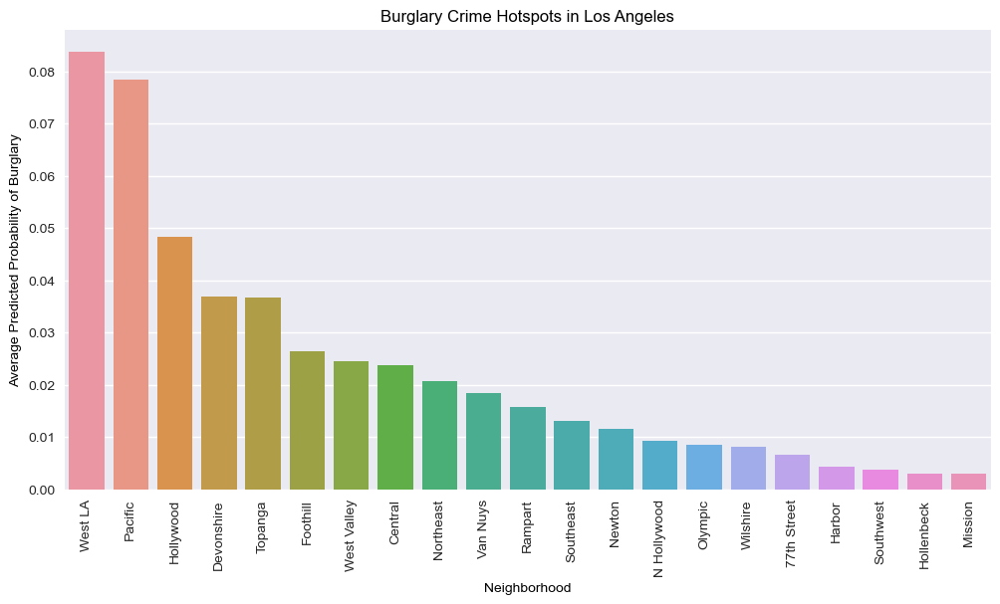

In [174]:
#code block 174
plt.figure(figsize=(12, 6))
sns.barplot(x='AREA NAME', y='Target_Burglary', data=crime_hotspots)
plt.xticks(rotation=90)
plt.xlabel('Neighborhood')
plt.ylabel('Average Predicted Probability of Burglary')
plt.title('Burglary Crime Hotspots in Los Angeles')
plt.show()

 <div style="background-color:#3b528b;  color:white; padding:20px">

<a href="#99" style="color:white;"> Top ⬆️</a>

<a id="5"></a>

<h2> Summary and Reflection:🎯</h2>
</div>


From the three model’s summary table, we could get Logistic Regression: The model labeled very few cases as "burglary",
leading to low recall and precision scores for both classes. The F1-score is also very low, indicating that the model's performance is not satisfactory.
Decision Tree: The decision tree model predicts a higher number of "burglary" cases compared to logistic regression. 
However, it still has relatively low recall and precision scores for both classes, resulting in low F1-scores.
Random Forest: The random forest model shows improved performance compared to the other models. It has higher recall and precision scores for both classes, indicating better ability to correctly identify actual burglary incidents while minimizing false positives.
